# **Week 1**: Advanced Model Training and Tuning
***

In this week we'll see:

+ Hyper-parameter tuning strategies
+ Automated hyper-parameter tuning on AWS SageMaker
+ Automated hyper-parameter tuning on a BERT-based classifier model.
+ Warm start to speed-up tuning jobs
+ Checkpointing in machine learning in AWS to save costs (managed spot training)
+ Distributed training strategies introduction

## Advanced Model Training and Tuning 
The goal of **model training** process is to fit the model to the underlying data patterns in your training data and learn the best possible parameters for you model (*e.g.* node weights and biases; the RoBERTa model we've been working with comes with 125 million parameters). 

In contrast **model hyper-parameters** need to be defined before the training process starts because these hyper-parameters influence the model learning process (*e.g.* learning rate, number of epochs). 

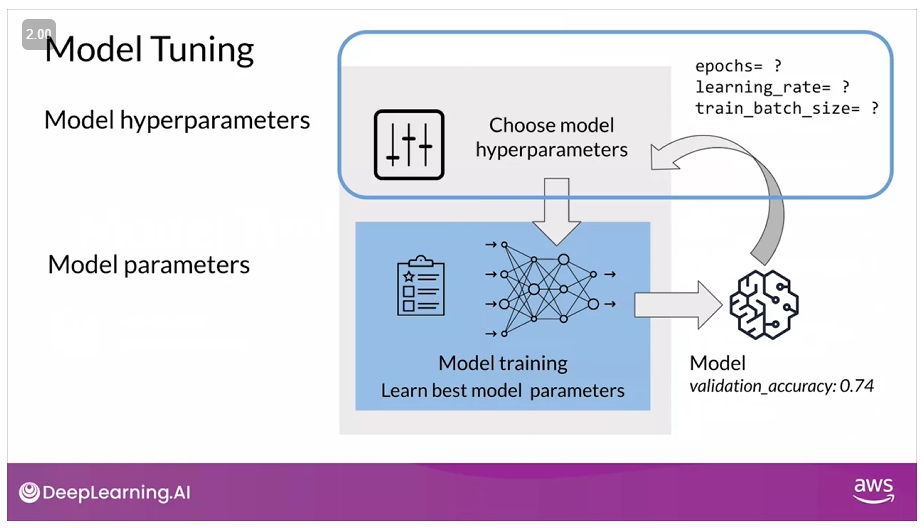

You evaluate the model's performance continuously during the model training process using a holdout validation dataset. During this cycle process you fine-tune both your parameters and hyper-parameters as necessary. Once our have tuned both your parameters and hyper-parameters, you evaluate the final model with a holdout test dataset, which the model has never seen. This final evaluation is what you use to compare your candidate final models: the better the test evaluation, the better is the model's ability to generalize.

### Hyper-Parameter Tuning Algorithms

When you start developing a model, you'll usually use hand-picked hyper-parameters (generally there is good guidance to pick default values). Once you have validated your selections of algorithm, code and dataset, then you can leverage tools for **automatic model tuning** to **fine-tune model hyper-parameters**. These are some of the most popular algorithms for automatic model tuning:

+ **Grid search**: you define a hyper-parameter space ranges. The you test *every* combination of hyper-parameters and select the best performing combination. An advantage of this approach is that you can explore all the combinations, arriving to the best set of hyper-parameters; this works well for a small number of hyper-parameters. However, this usually is time-consuming and doesn't scale well to large numbers of hyper-parameters.
+ **Random search**: you also define a hyper-parameter space ranges and a stop criteria (*e.g.* time elapsed, or number of iterations). In this case the algorithm tests *random* combination within the search space, and selects the best performing hyper-parameter combination, until the stop criteria is fulfilled. This results in a faster process compared with grid search, at the cost of potentially missing better performing hyper-parameters.
+ **Bayesian optimization**: in this case you also must define a hyper-parameter space ranges. After that, you apply the same logic used to optimize the parameters to the hyper-parameters: you treat the hyper-parameter optimization as a *regression* problem (*surrogate model*). You start from random hyper-parameters and narrow down the search space around better performing hyper-parameters. This means that this algorithm is more efficient in finding the best possible hyper-parameters because it continues to improve on the results from previous searches. However, this means that it requires sequential execution, and also could get stuck in local minima.
+ **Hyperband**: this is the newest approach for hyper-parameter tuning. It is based on *bandit approach*, which typically use a combination of exploitation and exploration to find the best hyper-parameters. You start from a large space of hyper-parameters, then you explore a random subset of these hyper-parameter combinations for few iterations. You then discard the worst performing half of the hyper-parameter combinations. In the subsequent iterations, you explore the best combinations. You continue this process until the set-time has elapsed or you reach the maximum iterations defined or you remain with one possible candidate. This means that this algorithm spends time efficiently (explore-exploit theory); but it might discard good candidates early that converge slowly. 

## Tune a BERT-based Text Classifier
**SageMaker hyper-parameter tuning** finds the best version of the model by running multiple training jobs on your dataset using the hyper-parameter range values that you specify. Additionally you can provide an objective metric and a tuning strategy. 

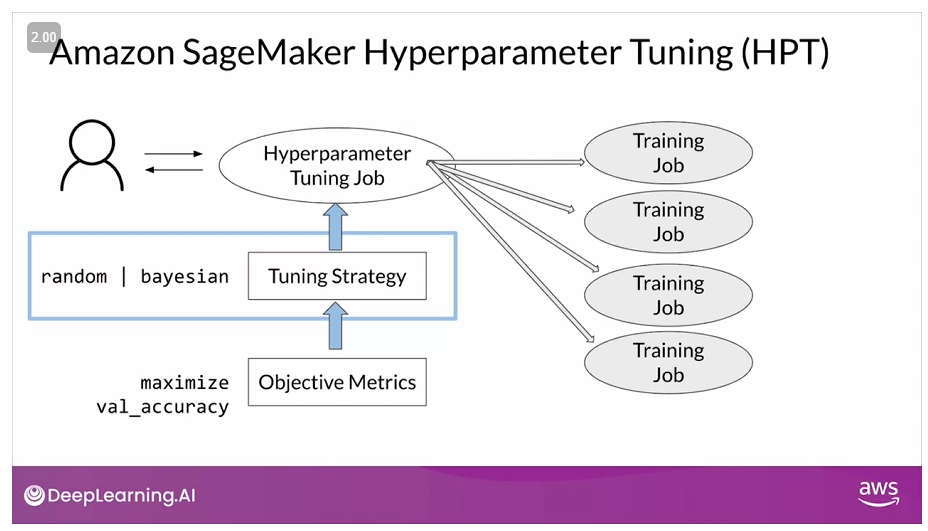

SageMaker natively supports *random* and *bayesian* tuning strategies. You can extend this functionality by providing an implementation of another tuning strategy as a docker container. 

In this example we want to maximize the validation accuracy metric, using random search. We'll tune the `learning_rate` and the `train_batch_size`. SageMaker behind the scenes runes multiple parallel training jobs and returns the training job with the best possible validation accuracy. There are three steps in this process:

**1. Create the PyTorch estimator** 

In this step you define fixed hyper-parameters, defined as a dictionary

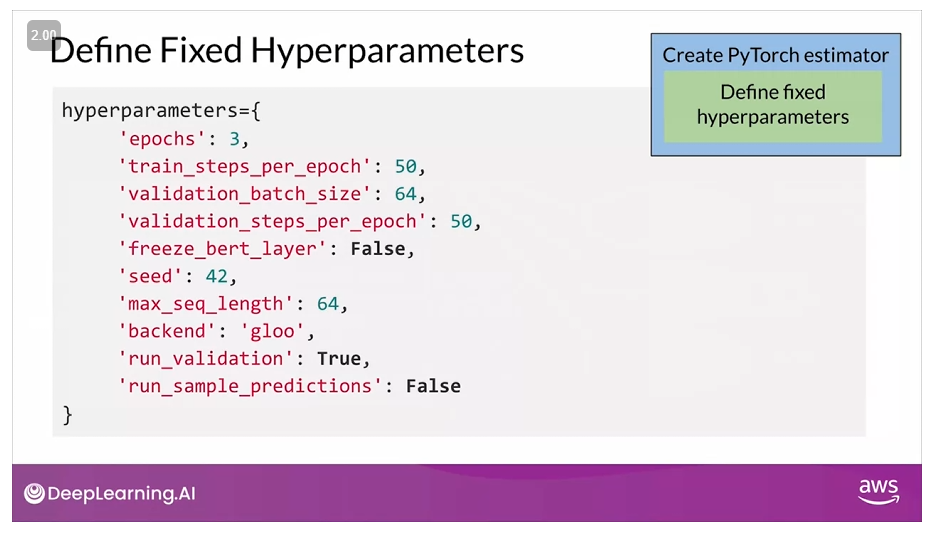

Then we create the PyTorch estimator and pass in the fixed hyper-parameters dictionary

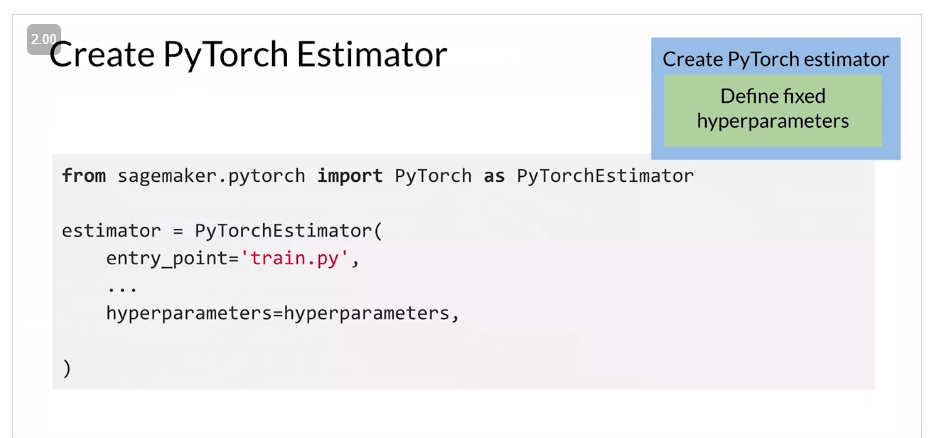


**2. Create the hyper-parameter tuning job (HPT)**

In this step you first define the hyper-parameters that you want to tune (in this example just the `learning_rate` and `train_batch_size`). Here you define the hyper-parameter type (categorical, continuous or integer). 

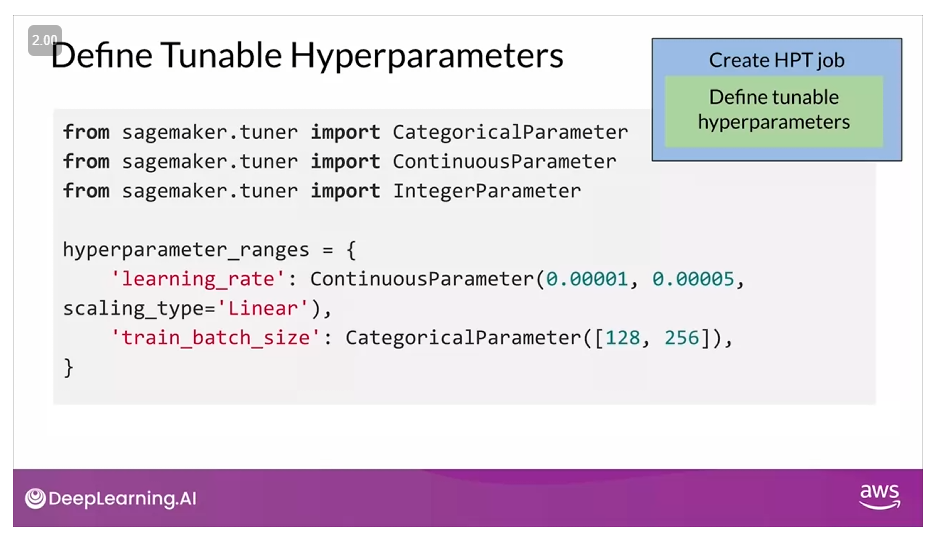

For the **categorical** type you should assign hyper-parameters that you assign specific values (*e.g.* boolean values, a defined set of values such as the optimizer type, etc.). For **integer** type, you usually use this if you want to define a range of values, and you can also define a `scaling_type` to exclude some ranges. Finally for **continues** you want to explore the values between the low and high values for a specific range.

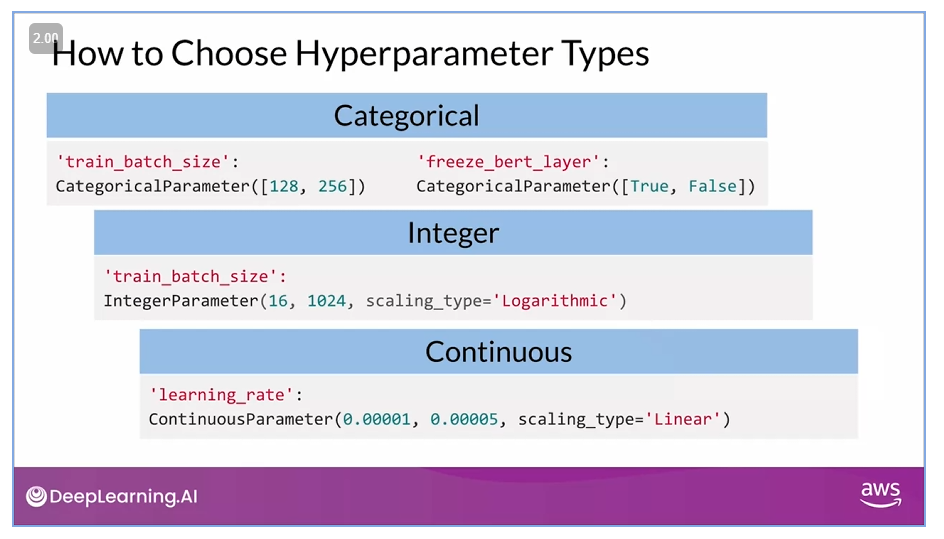

Then we define the HPT job, using the hyper-parameters defined above, along with the target metric, and the job type. And then you run the job.

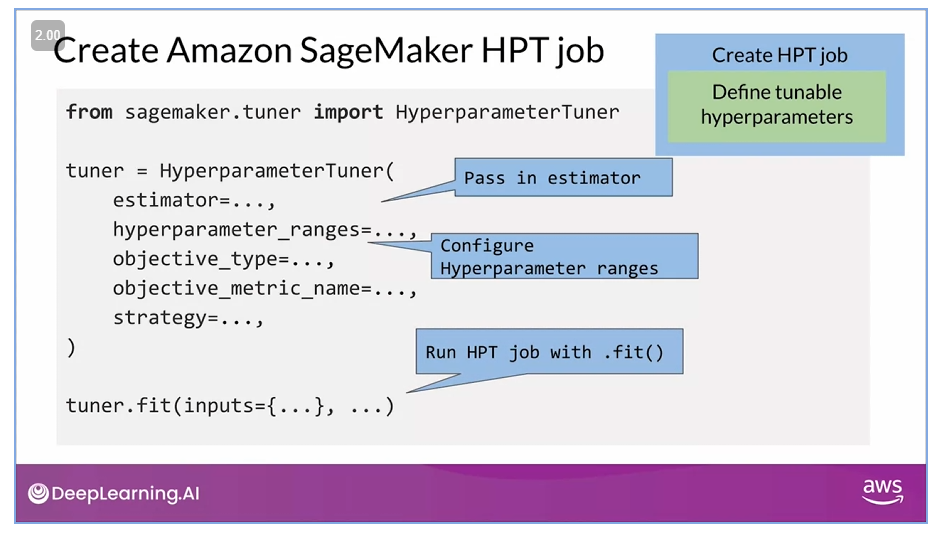

**3. Analyze the results**

Behind the scenes the `fit` method is kicking off multiple training jobs that will explore all the hyper-parameter ranges that were configured. To analyze the results you can just call a data frame where the results were stored.

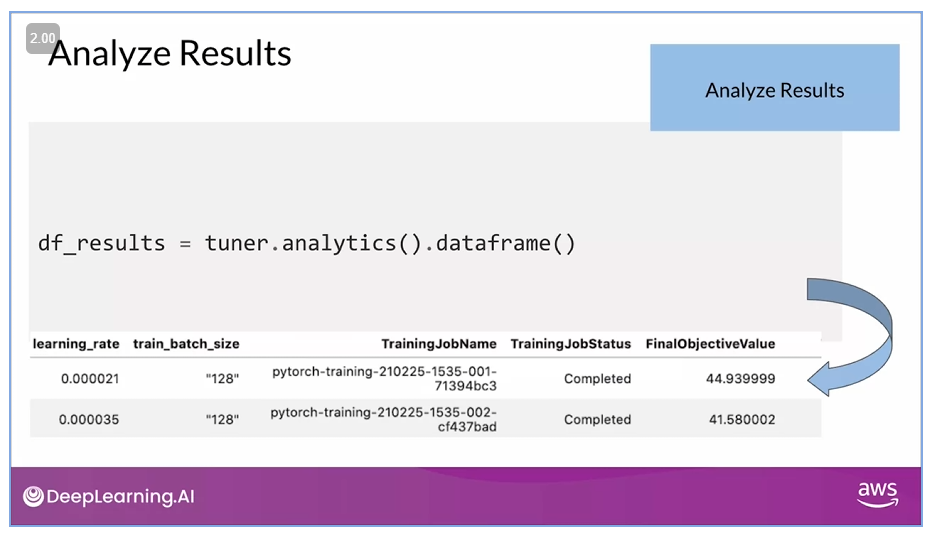

**Warm starting HPT** reuses prior results from a previously completed HPT or a set of completed HPTs to speed up the optimization process an reduce the overall cost. This is useful if you want to change the hyper-parameter tuning ranges from the previous job, or if you want to add new hyper-parameters to explore. Both situations can use knowledge from the previously completed job to speed up the process and find the best model quickly. There are two different type of warm starts supported:

+ `IDENTICAL_DATA_AND_ALGORITHM`: uses same input data, training data and tuning algorithm as the parent tuning job. You can update the hyper-parameter tuning ranges and maximum number of training jobs.
+ `TRANSFER_LEARNING`: updated training data and different version of training algorithm (perhaps you have collected more data for your training process and you want to explore different algorithm options).

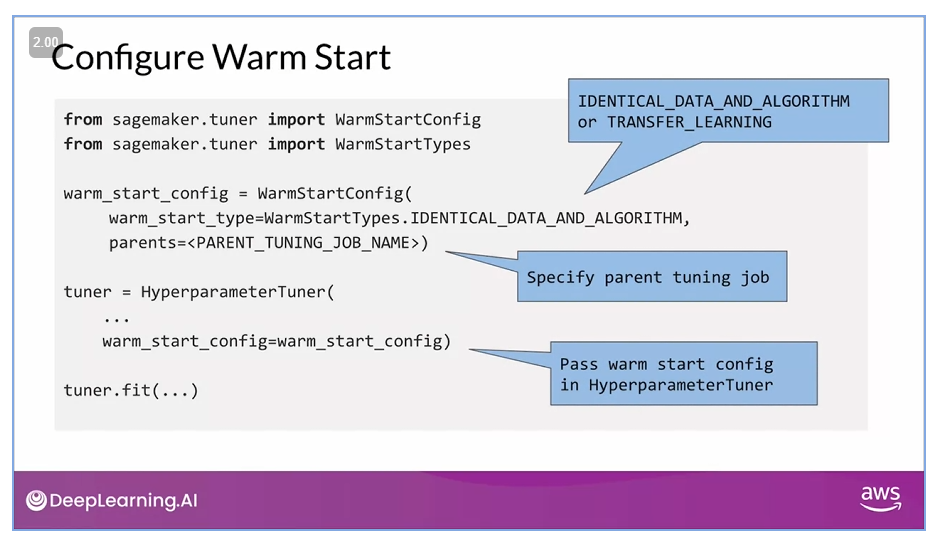

### Best Practices - SageMaker Hyper-Parameter Tuning
1. **Select a small number of hyper-parameters**: this is a time and computation intensive task. The computational complexity is directly proportional to the number of hyper-parameter at a time. However, choosing a smaller number of hyper-parameters to tune will typically yield better results. SageMaker allows you to tune about 20 hyper-parameters at a time.
2. **Select a small range for hyper-parameters**
3. **Enable warm start** to leverage previous tuning jobs
4. **Enable early stop to save tuning time and costs**: this avoids wasting resources if the algorithm doesn't make improvements
5. **Select a small number of concurrent training jobs**: on one hand, if you use a larger number of concurrent jobs, the tuning process will be completed faster. But in fact, the hyper-parameter tuning process is able to find best possible results only by depending on the previously completed training jobs. 
6. **Monitor training resources**: find the right size of compute resources, which required empirical testing and CloudWatch metrics. You can also use the insight form Amazon SageMaker Debugger, as it reports on resource metrics (CPU, GPU and memory utilization).

## Checkpointing and SageMaker Managed Spot
Machine learning training is usually a long-time intensive process: it could run for multiple hours or even multiple days. If these long-running training jobs stop for any reason such as power failure, owns fault or unforeseen errors, then you'll have to start the training job from the very beginning. This leads to lost productivity and increase costs. Even if you don't encounter errors or problems, there are scenarios where you want to start experiments from a known state. In these situations you'll use machine learning **checkpoint**.

**Checkpointing** is a way to save the current state of running training job so the training job, if stepped, can be resumed from a known state. These are basically snapshots of the model in training and include details like model architecture, which allows you to recreate the model training once it stopped (it also includes model's weights learned so far). It also stores training configuration, loss observed during training, optimizer state (this is important to resume the optimization process).

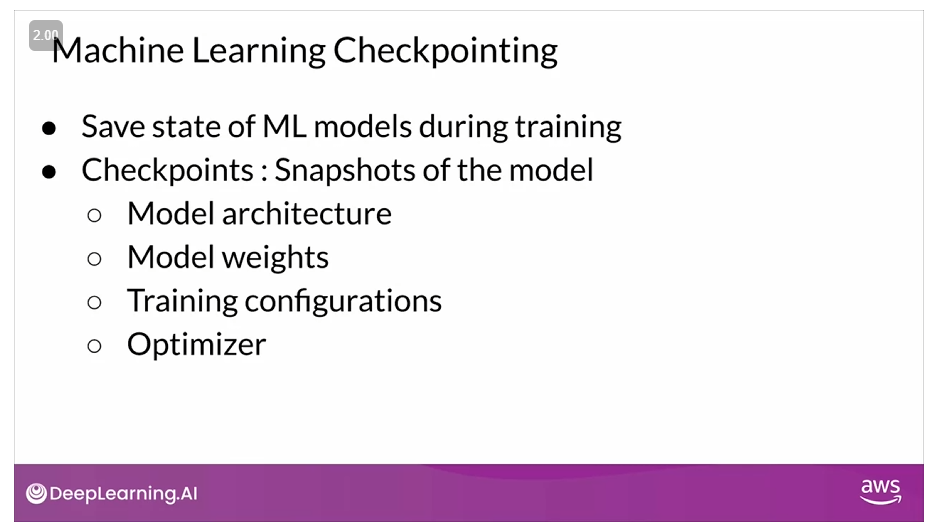

When using checkpointing you have to consider two important things:
+  Frequency of checkpointing
+ Number of checkpoints

Having frequent checkpoints and lots of files will lead to a rapid usage of storage, at the benefit of having the capability of resuming training at any moment without losing much information. On the other side, you can save storage by lowering the frequency or number of files, at the cost of lowering your productivity in case a problem occurs. You must balance these two factors.

**Amazon SageMaker Manged Spot** is based on the concept of *Spot Instances* that offer speed and unused capacity to users at discount prices. Managed Spot uses these instances for hyper-parameter tuning and training and leverages machine learning checkpointing to resume training jobs easily. 

You start a training job on a docker container on a Spot Instance. Since Spot Instances can be preempted and terminated with just a two-minute notice, it is important that your `train.py` file implement the ability to save checkpoints, and the ability to resume from checkpoints. SageMaker Managed Spot does the remaining: it automatically back up the checkpoints to an S3 bucket. In case a Spot Instance is terminated because lack of capacity, Managed Spot continues to pull additional capacity. Once the additional capacity becomes available, a new Spot Instance is created to resume your training and the service automatically transfers all the dataset as well as the checkpoints that were saved into S3 into your new instance so that training can be resumed.

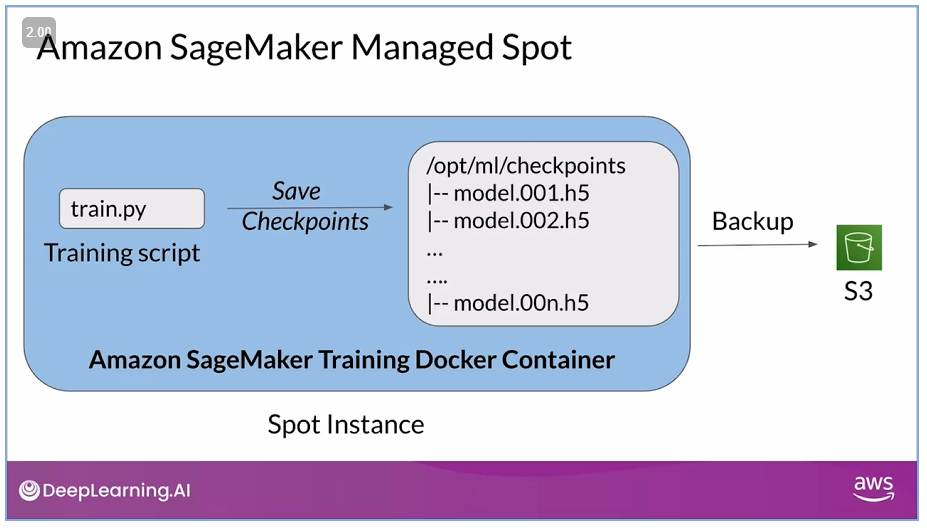



## Distributed Training Strategies
Training at scale challenges comes in two flavors:
+ **Increased training data volume**
+ **Increased model size and complexity**

There is a limit on the amount of data or model size and complexity that you can fit in a single computing instance. Both lead to an increase number of computations, that result in long running training jobs. 

**Distributed training** is a technique used to address the scale challenges in training. Here the training load is split across multiple CPUs and GPUs, also called as devices within a single compute node; or the load can be distributed among different compute nodes in a compute cluster.

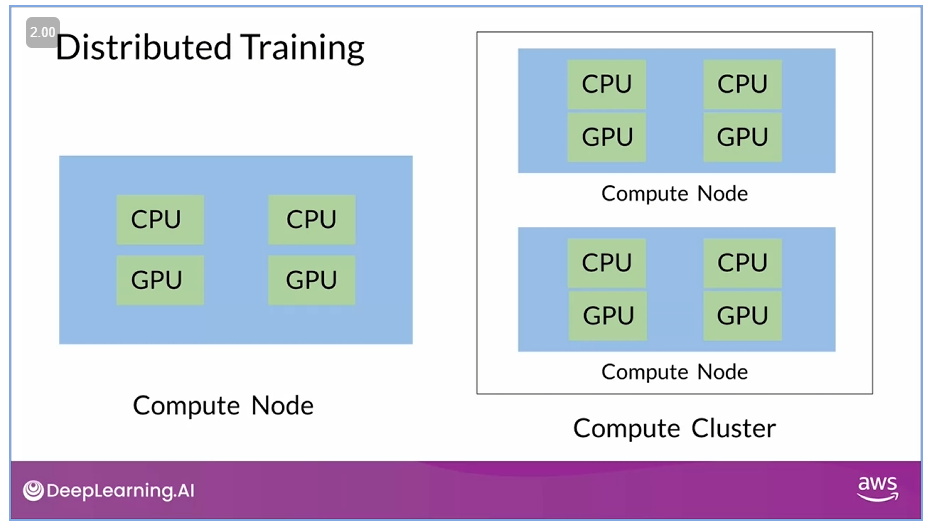

Regardless whether you choose to distribute the training load within a single compute node or across multiple compute nodes, there are two distributed training strategies at play:

1. **Data parallelism**: the training data is split up across the multiple nodes that are involved in the training cluster. The underlying algorithm (*e.g.* neural network) is replicated on each individual nodes of the cluster. Now, batches of data are retrained on all nodes using the algorithm and the final model is a result of combining the results from each individual node.
2. **Model parallelism**: the underlying algorithm (*e.g.* neural network) is split across the multiple nodes. Batches of data are sent to all of the nodes so that each each batch of the data can be processed by the entire neural network. The results are once again combined for a final model. 

For selecting a distributed training strategy always keep in mind that if your training across multiple nodes or multiple instances, there is always a certain training overhead. The training overhead comes in the form of inter-node communication because of the data that needs to be exchanged between the multiple nodes of the cluster. Below is a flow chart for selecting the distributed training strategy.

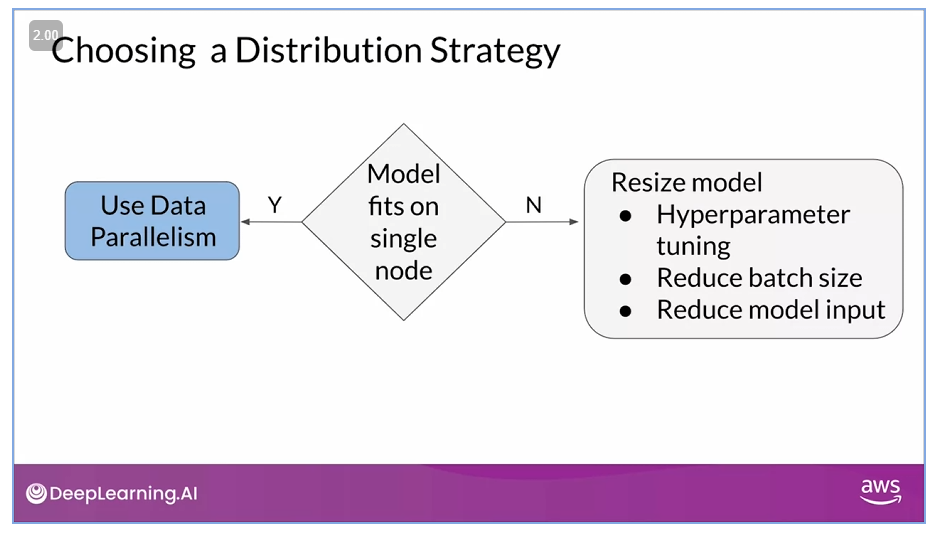

If even after resizing the model it doesn't fit on a single node, then you should use **model parallelism**.


### Code Example

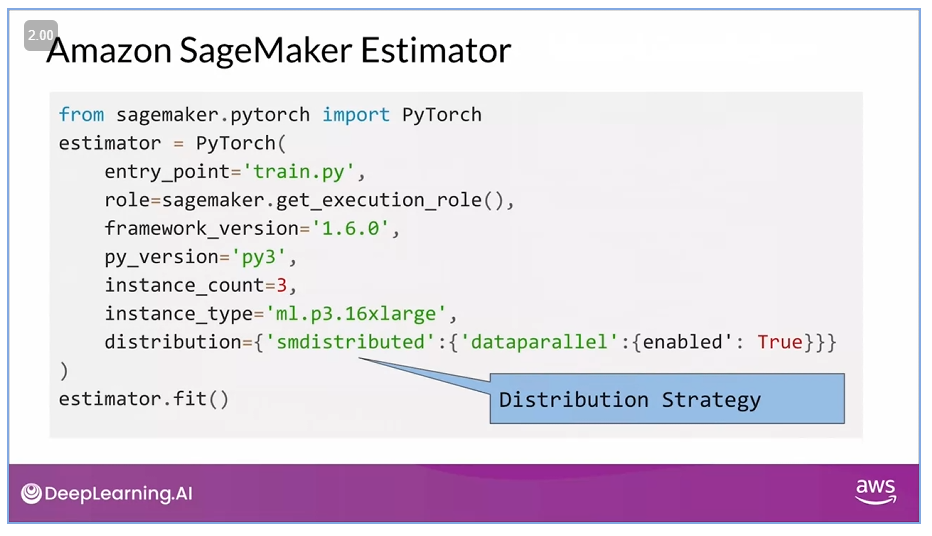

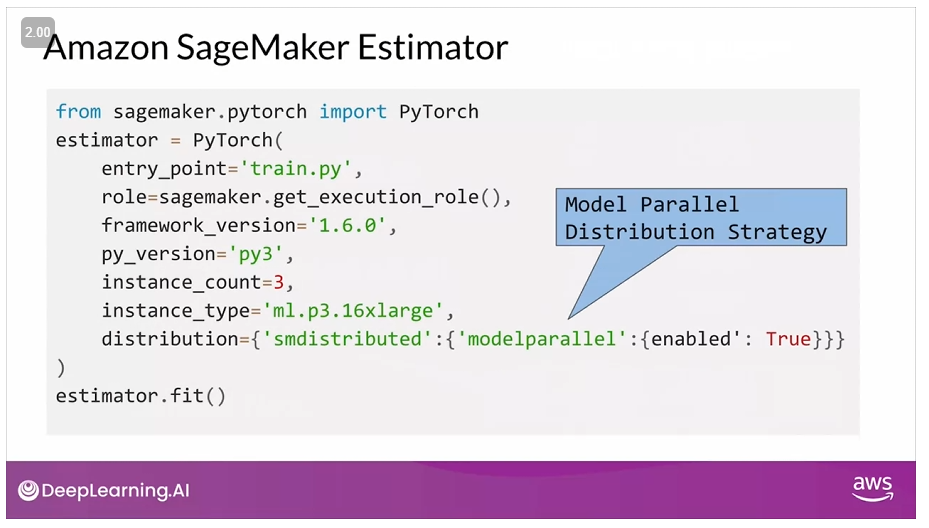

## Custom Algorithms with Amazon SageMaker
We've seen how to use SageMaker's built-in algorithms, as well as your own training scripts with SageMaker supported frameworks such as TensorFlow, PyTorch in SageMaker provided containers. However you can use your own custom algorithms implementation, your own training and inference logic in the infrastructure managed by SageMaker. In all cases you need containers for your models

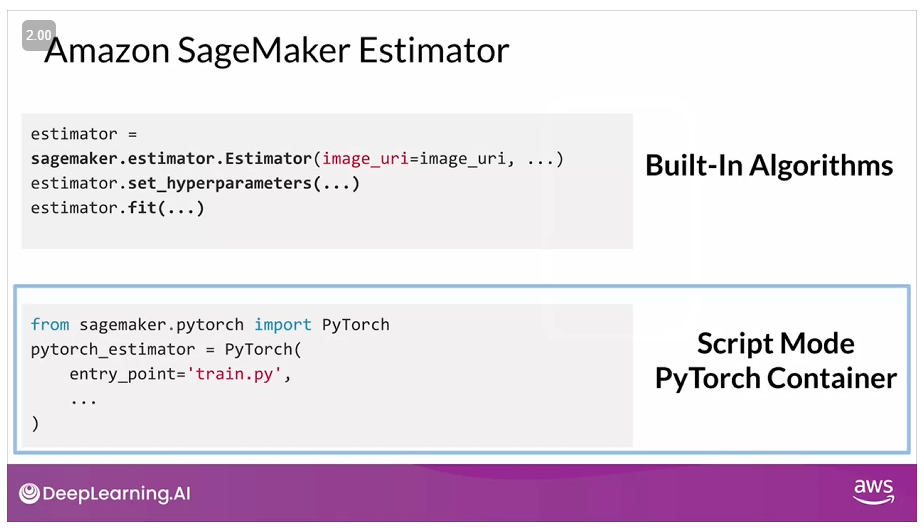

For the custom algorithm you must also bring a custom container. This consist of 4 steps

1. Create the code that captures all the logic

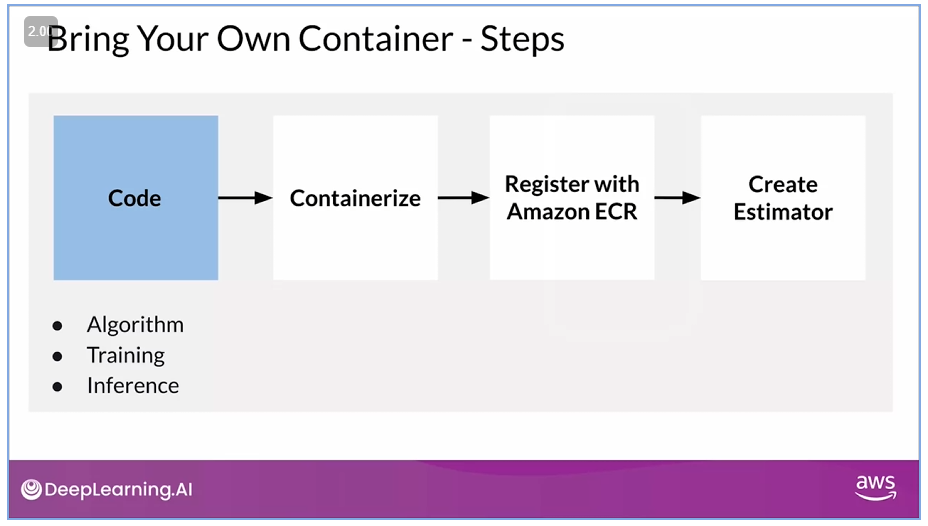

2. Containerize the code

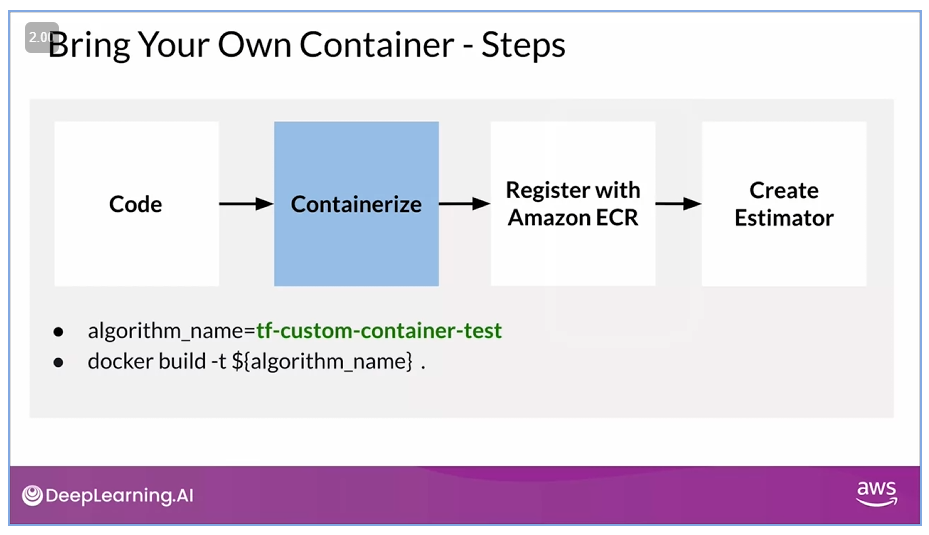

3. Register the container with Amazon ECR (Elastic Container Registry)

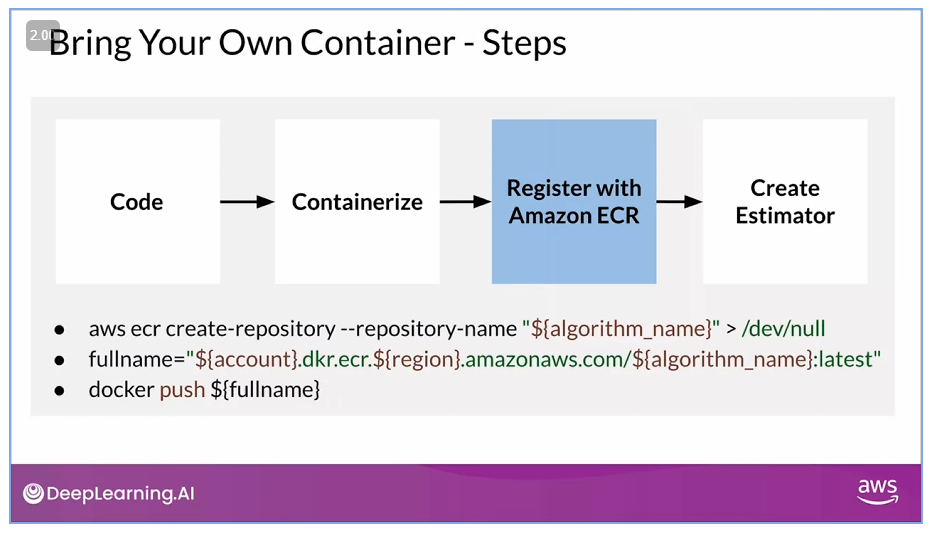

4. Create estimator using the image URI from the container registered in ECR

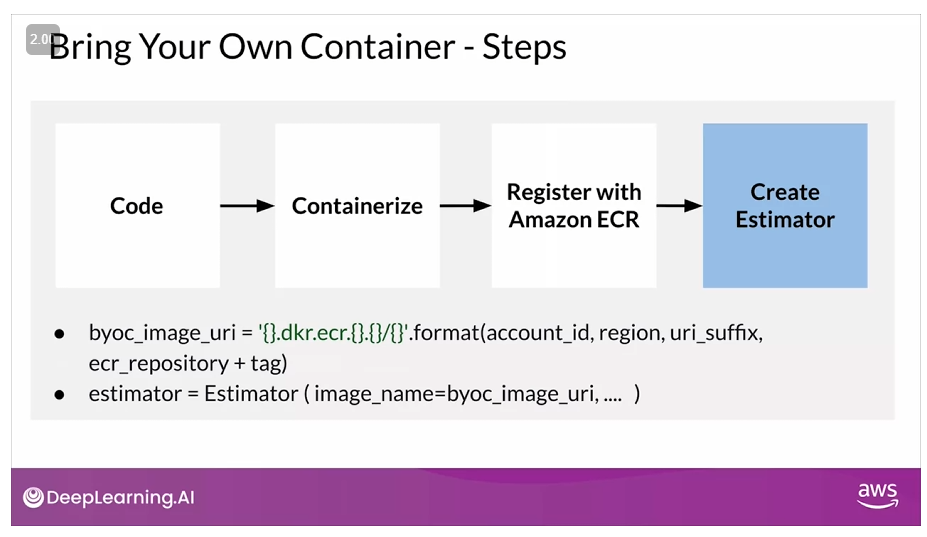



# **Week 2**: Advanced Model Deployment and Monitoring
***

## Model Deployment Overview
In this section we'll focus on deploying in the could. There are different deployment strategies that will depend on the overall machine learning workflow.

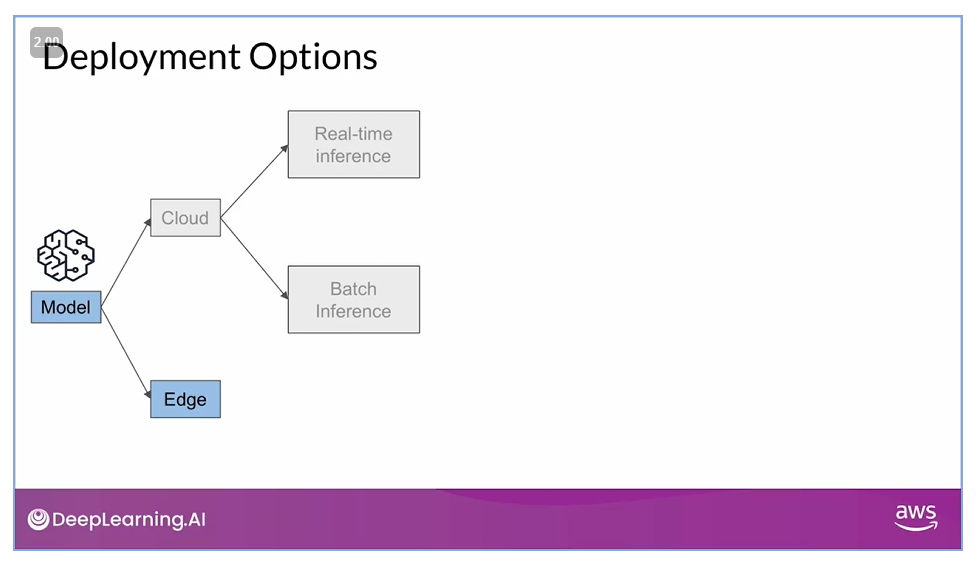

### Real-Time Inference
**Real-time inference** means deploying the model to a persistent hosted environment that's able to serve requests for prediction and provide prediction responses back in real time or near real time. This involves exposing an endpoint that has his serving stack that can accept and respond requests. A serving stack needs to include a proxy that can accept incoming requests and direct them to an application that then uses your inference code to interact with your model.

This is a good option when you need to have a low latency combined with the ability to serve new prediction requests that come in (*e.g.* fraud detection).

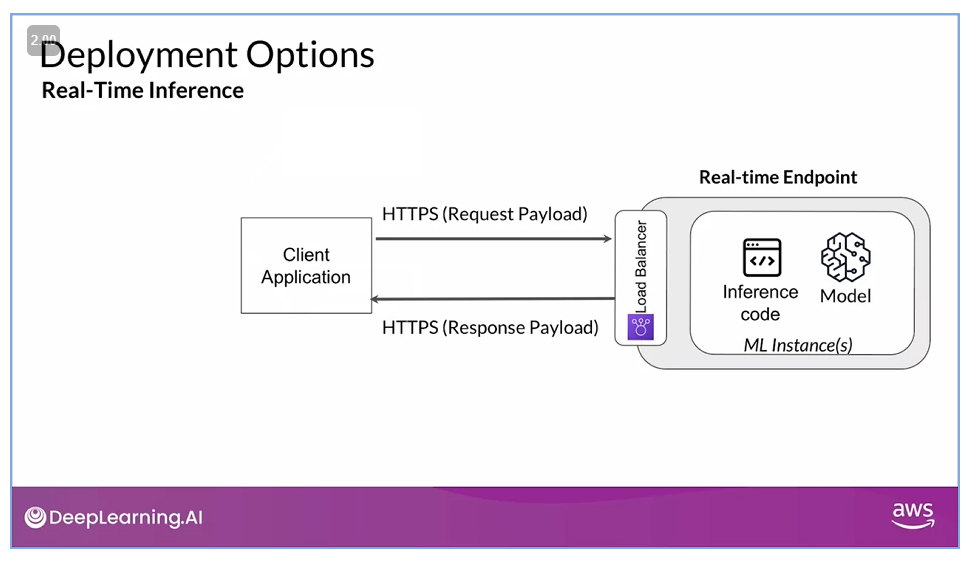

An example for the RoBERTa model we've been working with, is to classify in real time user reviews of some app or product; if the model classifies the review as negative, generate a ticket to look into solving the issue.

### Batch Inference
In the case of **batch inference** you batch the requests for prediction, running a batch job against those batch requests and then out putting your prediction responses typically in a batch format. Once you have your prediction responses, they can be used in a number of different ways. This could mean reports, storage in a secondary data store for use for other applications, etc. Some use cases are related to forecasting. 

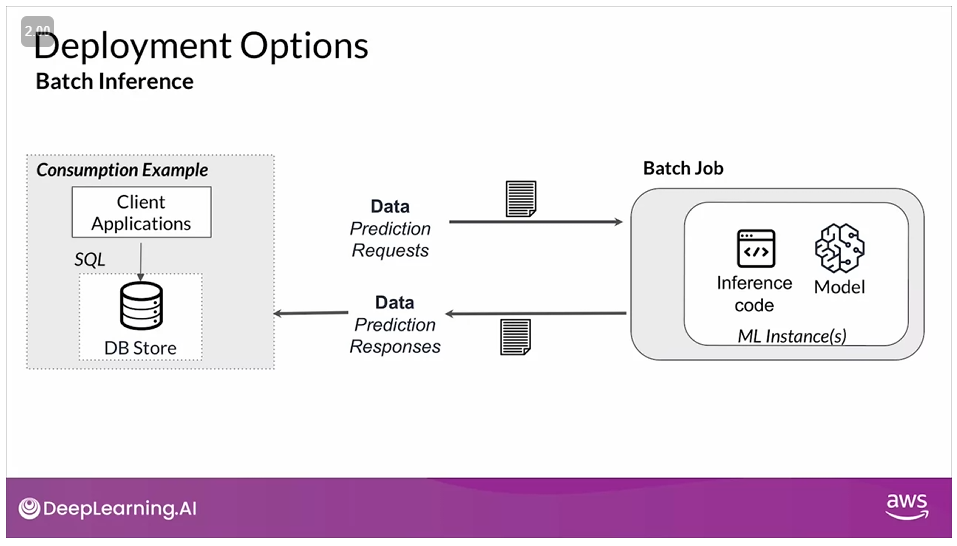

An example for the RoBERTa model we've been working with, is to identify vendors that have potential quality issues by detecting trends for negative product reviews per vendor. This wouldn't need real time, you need to run a batch process a the frequency required for the analysis. These jobs are not persistent, as they only run for only the amount of time that it takes to process those batch requests on input. 


### Deployment to the Edge
This type of deployment is not cloud specific. Here you want to deploy the models closer to your users or in areas with poor network connectivity. In the case of **edge deployments**, you train your models in another environment (*e.g.* cloud) and then optimize your model for deployment to edge devices. This process is typically aimed at compiling or packaging your model in a way that is optimized to run at the edge. This usually means things like reducing the model package size for running on smaller devices. In these cases you could use something like *SageMaker Neo* to compile your model in a way that is optimized for running at the edge and use cases. 

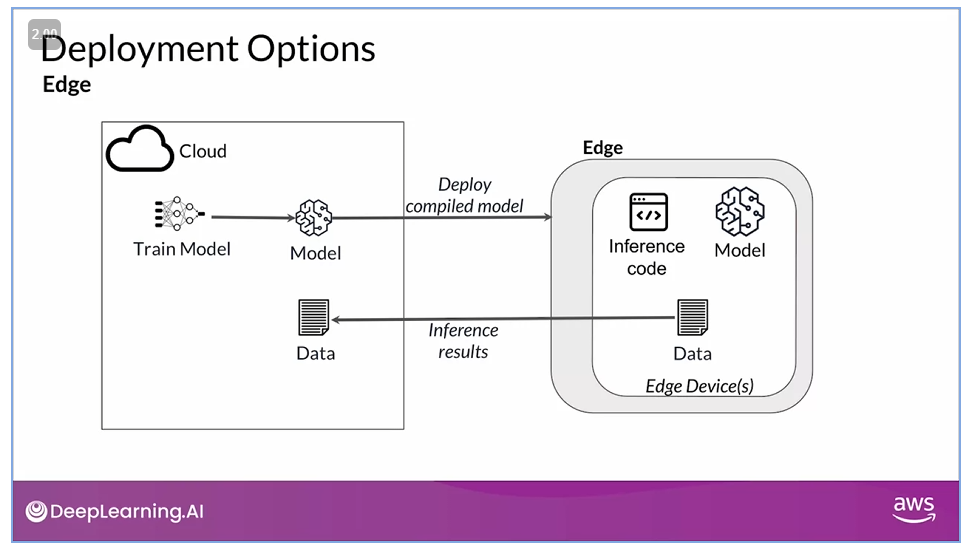

### Decision Factors

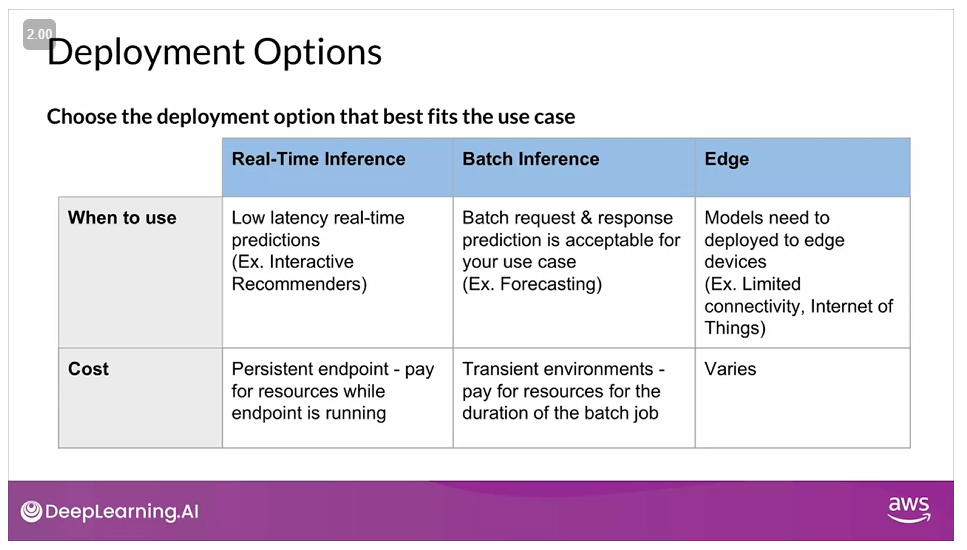

## Model Deployment Strategies
These strategies are important because you want to be able to deploy new models in a way that minimizes risk and downtime while measuring the performance of a new model or a new model version. You don't want to disrupt service, degrade the performance with live data, nor affect the product.

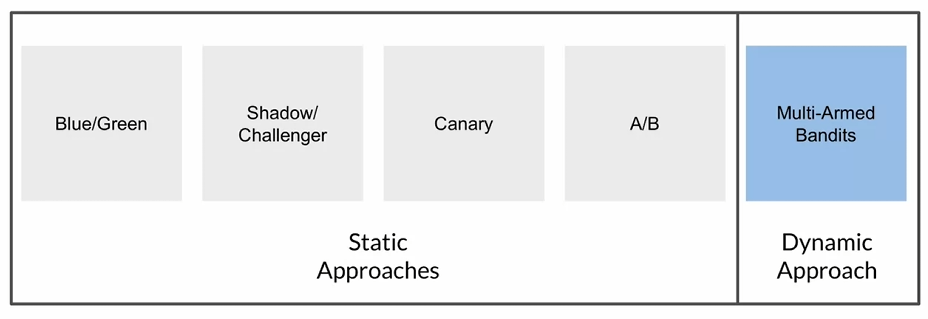

### Blue/Green Deployment
You deploy your new model version to a stack that conserved prediction and response traffic coming into an endpoint. When you're ready to have that new model version actually start to process prediction requests coming in, you swap the traffic to that new model version. This makes it easy to roll back because if there are issues with that new model or that new model version doesn't perform well, you an swap traffic back to the previous model version. 

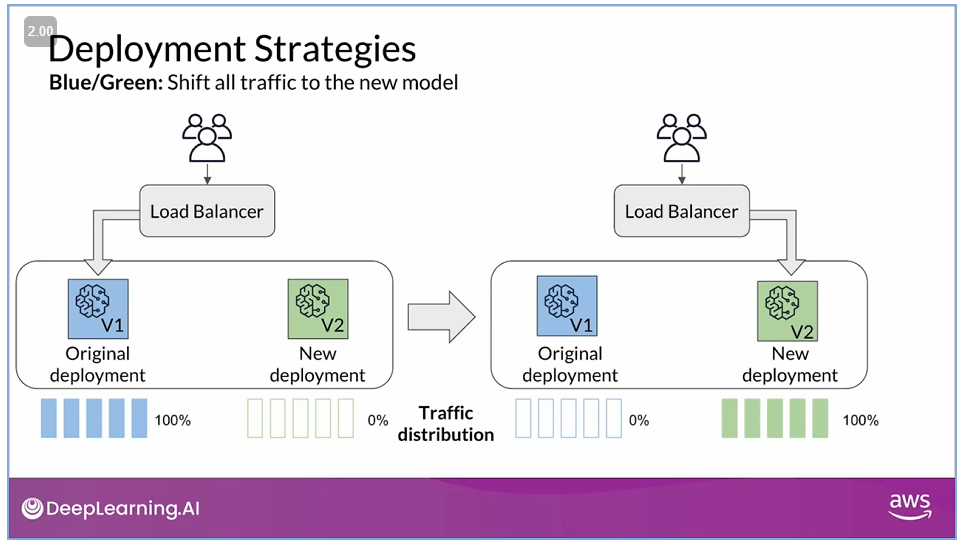

The downside of this strategy is that it is 100% swap of traffic. So, if the new model version  is not performing well, then you run the risk of serving bad predictions to 100% of your traffic versus a smaller percentage traffic. 

### Shadow/Challenger Deployment
You deploy your new model in production by letting the new version accept prediction requests to see how that new model would respond, but you're not actually serving the prediction response data from that new model version. This lets you validate the new model version with real traffic without impacting live prediction responses. 

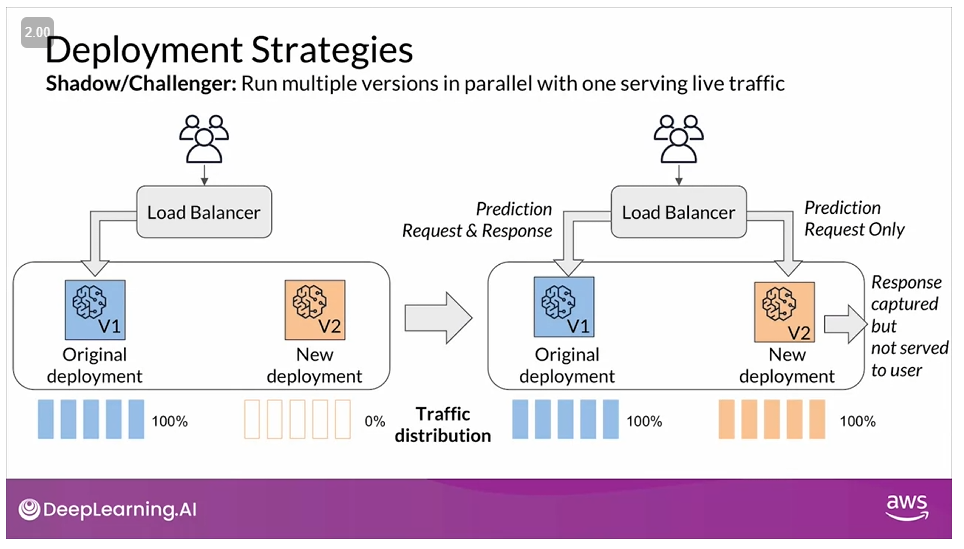

This strategy lets you minimize the risk of deploying a new model version that may not perform as well as the previous version, as you can analyze performance with live/new data as if it was deployed. Once you're comfortable with the new model version performance, you can actually start to serve prediction responses directly from the new model instead of the previous version.

### Canary Deployment
You split the traffic between model versions and target a smaller group to expose that new model version. Typically, you're exposing the select set of users to the new model for a smaller period of time to be able to validate the performance of that new model version before fully deploying that new version out to production. Canary deployments are good for validating a new model version with specific or smaller set of users before rolling it out to all users.

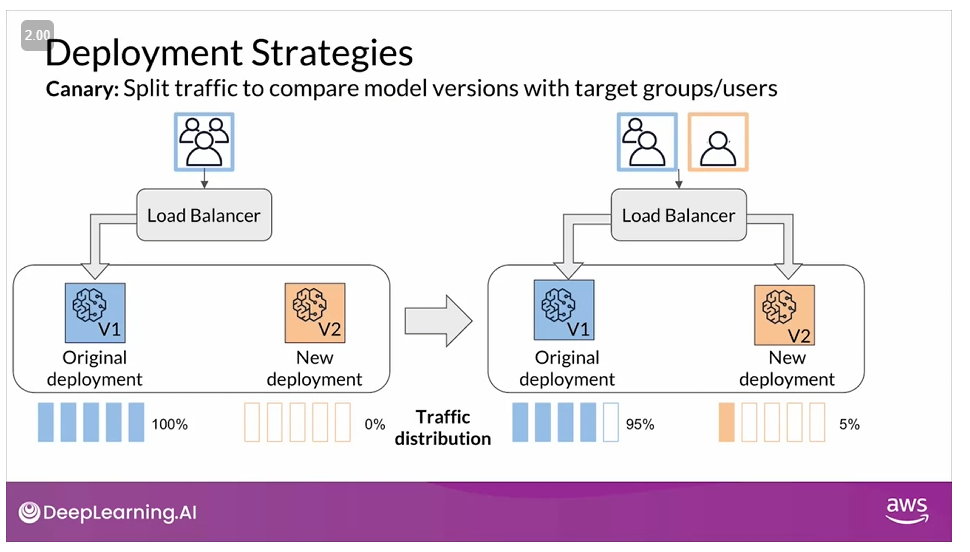

### A/B Testing Deployment
This strategy also splits traffic. However, with A/B testing deployment you split among larger groups and for longer periods of time to measure performance of different model versions over time. This split can be done by targeting specific user groups or just by setting a percentage of traffic to randomly distribute to different groups. 

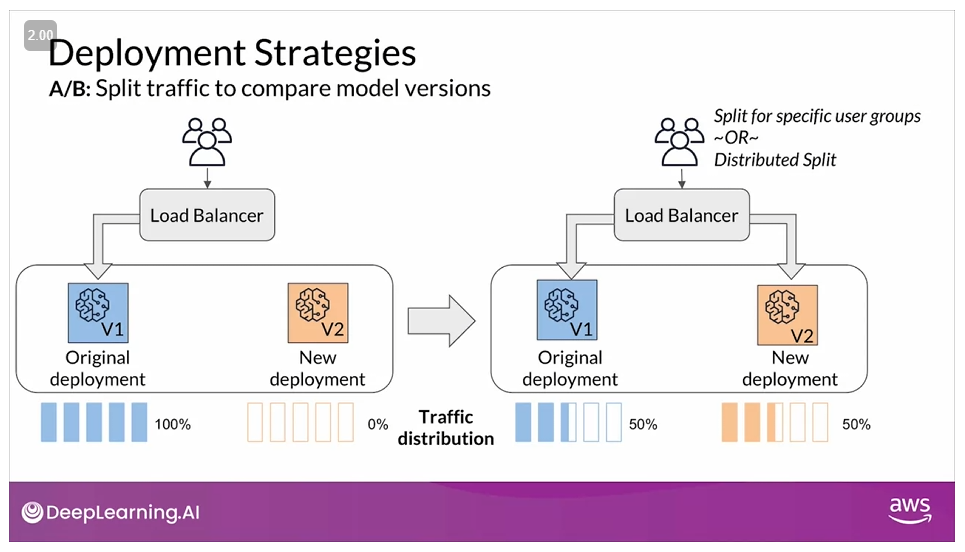

You can also perform A/B testing between more than two model versions. This also can results in a more robust analysis and comparison between model versions, increasing the roll-out confidence for the deployment.

### Muli-Armed Bandits Deployment
For this approach, instead of manually identifying when and how you distribute traffic, you can take advantage of approaches that incorporate machine learning to automatically decide when and how to distribute traffic between multiple versions of a deployed model. Multi-armed bandits (MABs) generates a dynamic testing method for model version using Reinforcement Learning; it dynamically shifts traffic to the winning model versions by rewarding the winning model with more traffic but still exploring the non-winning model versions in the case that those early winners were not the overall best models.

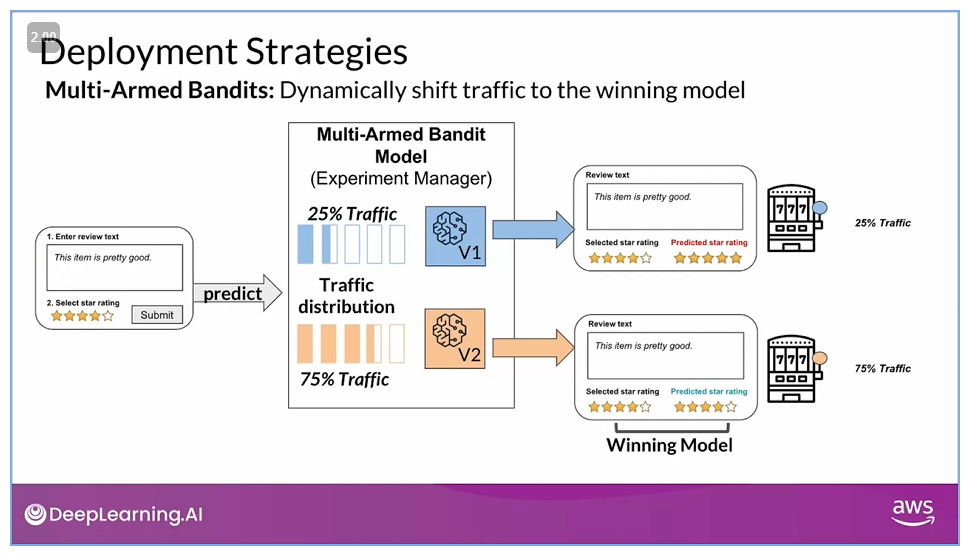

## Amazon SageMaker Hosting: Real-Time Inference
**SageMaker Endpoints** can be used to server your models for predictions in real-time with low latency. This requires a model serving stack that has your pre-trained model and  a hosting stack that's able to serve those predictions. This hosting stack usually contains some type of proxy, a web server that can interact with your loaded serving code and your trained model. Your model can then be consumed by client applications through real time invoke API request. The request payload sent when you invoke the endpoint is routed to a load balancer and then routed to your machine learning instance or instances that are hosting your models for predictions.

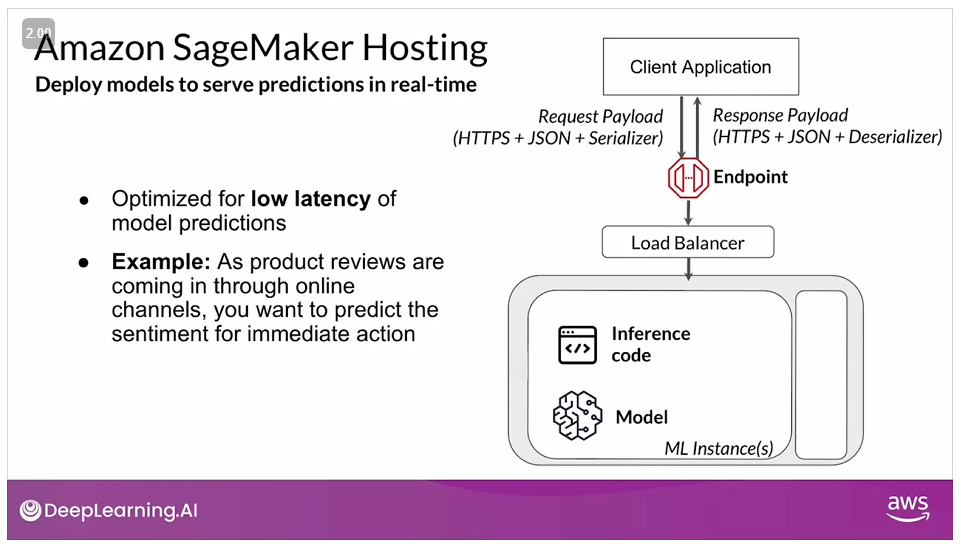

SageMaker has several built-in serializers and deserializers that you can use depending on your data formats. For example for serialization on prediction request, you can use the JSON line serializer, which will then serialize your inference request data to a JSON lines formatted string. For deserialization on prediction response, the JSON deserializer will then deserialize JSON lines data from an inference endpoint response.Finally, the response payload is then routed back to client application. 

With **SageMaker Model Hosting** you choose the machine learning instance type, as well as the count, combined with the docker container image and optionally the inference code, and then SageMaker takes care of creating the endpoint, and deploying that model to the endpoint. The type of ML instance you choose really comes down to the amount of compute and memory you need. 

As we've seen there are three main ways to deploy a model:

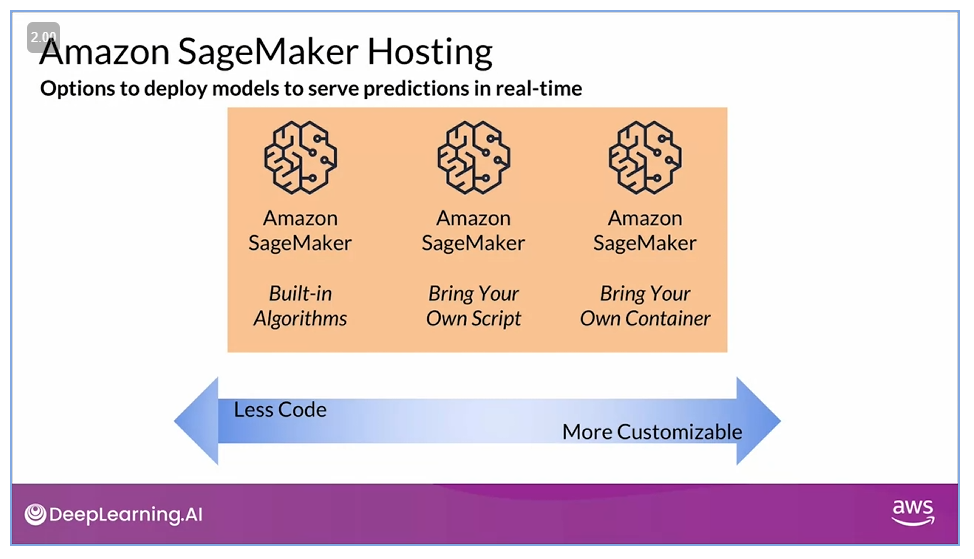

### Built-In Algorithm
This is the option that requires the less amount of code. In this option you use both pre-built inference code combined with a pre-built serving container. The container includes the web proxy and the serving stack combined with the code that's needed to load and serve your model for real-time predictions. This scenario would be valid for some of the SageMaker built-in algorithms where you need only your trained model and the configuration for how you want to host that machine learning instance behind that endpoint

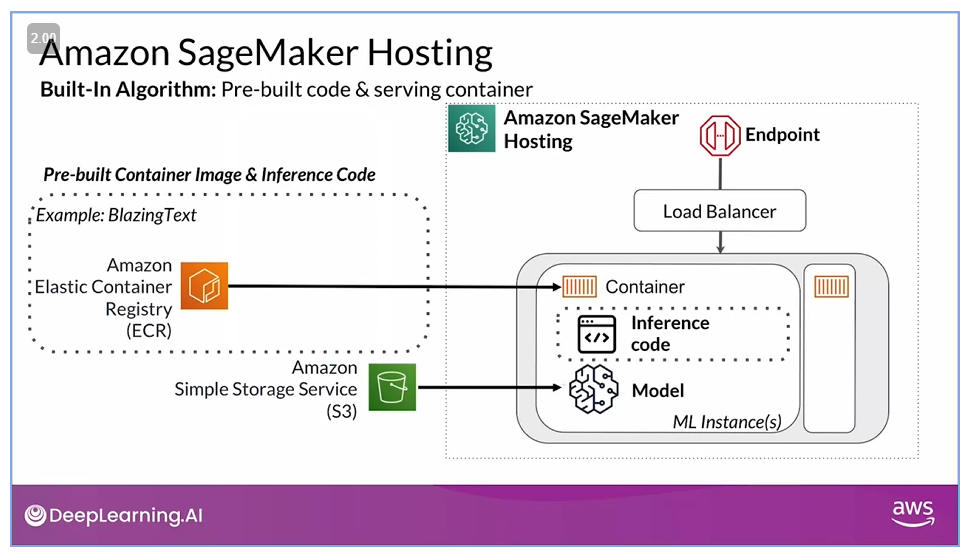

### Bring Your Own Script
This option still uses a pre-built container that's purposebuilt for a framework such as TensorFlow or PyTorch, and then you can optionally bring your own serving code. Here you might want to bring your own inference code. 

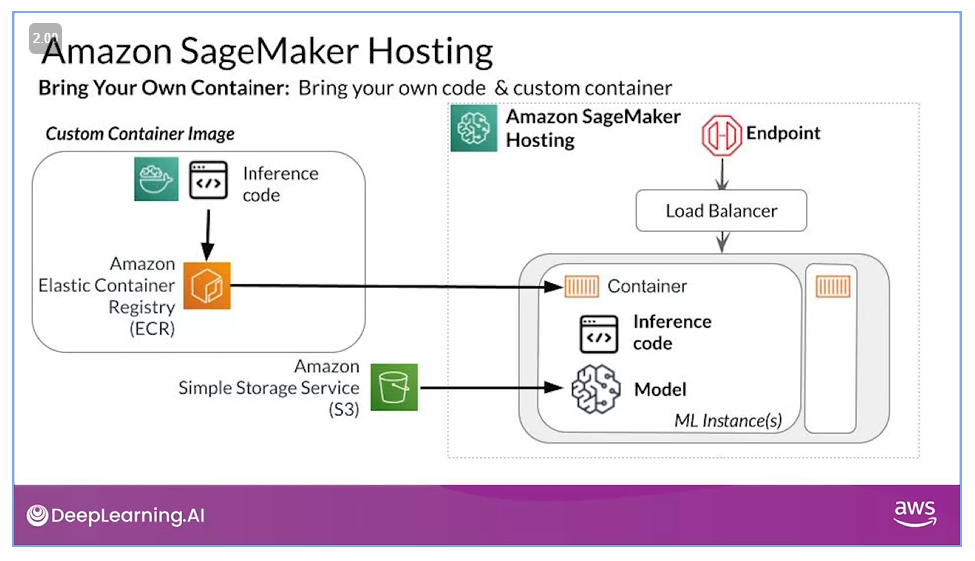

### Bring Your Own Container
In this case you need to create a container that's compatible with SageMaker for inference. But this also offers the flexibility to choose and customize the underlying container that's hosting your model. 

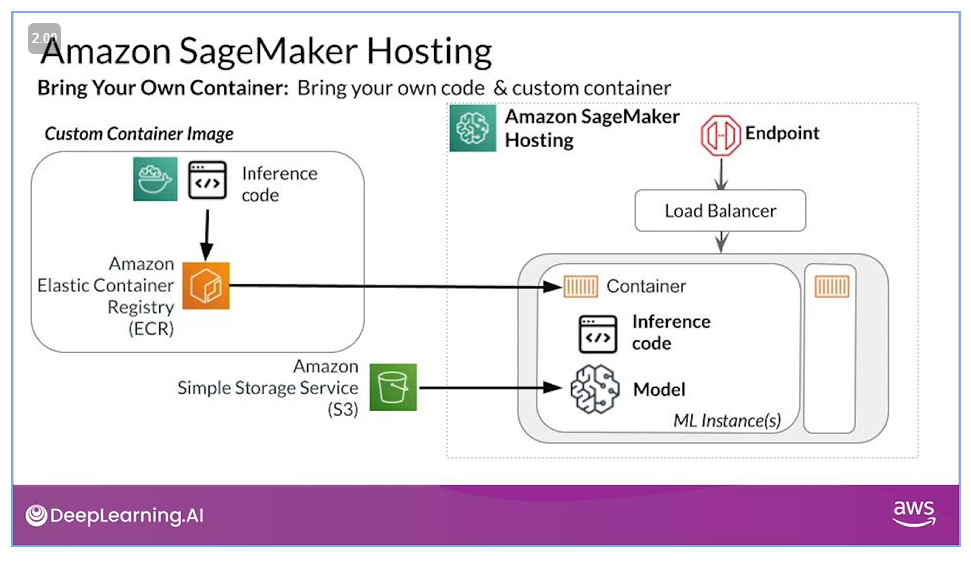

**All of these three options deploy your model to a number of machine learning instances that you specify when you're configuring your endpoint. You typically want to use smaller instances and more than one machine learning instance. In this case, SageMaker will automatically distribute those instances across AWS availability zones for high availability.**

### Auto-Scaling Endpoint
To ensure that you're able to scale up and down to meet the demands of your workloads without over-provisioning your ML instances. This is done using usage thresholds to add capacity. This is key for cost optimization, as you meet and fulfill the demand for your service as it grows, but also you can scale down as the demand lowers also.

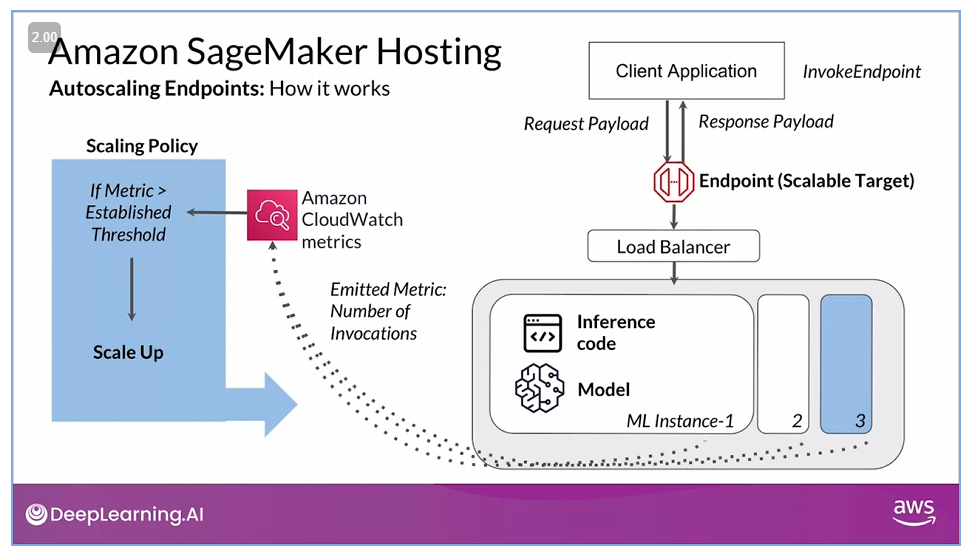

When you deploy an endpoint, the machine learning instances that back that endpoint will emit a number of metrics to **AWS CloudWatch** (it is the managed AWS service for monitoring your AWS resources). SageMaker emits a number of metrics about that deployed endpoint (*e.g.* utilization, invocation metrics). The invocation metric (measures the number of times an invoke endpoint request has been run against an endpoint) is the default scaling metric for SageMaker Auto-scaling (you can define a custom scaling metric as well).

As part of the scaling process that you define, if the selected metric exceeds the selected threshold, it will automatically scale-up by the number of instances you configures. You also can define a scaling cool-down policy, which is a value in seconds, which is the period intended to allow instances to scale out continuously, but not excessively. 

To set-up **Auto-Scale** you:

1. **Register a scalable target**: the scalable target is an AWS resource, in this case SageMaker resources

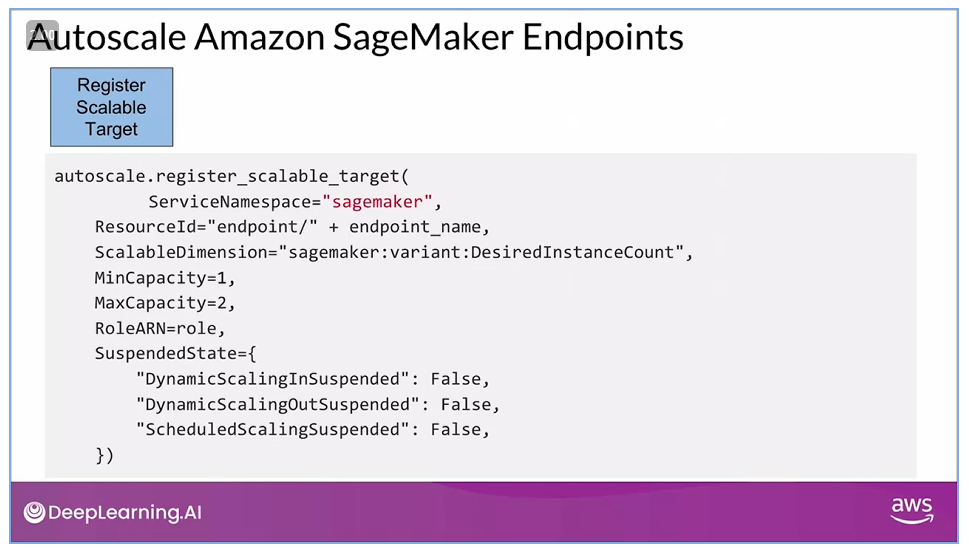

2. **Define the scaling policy**: 

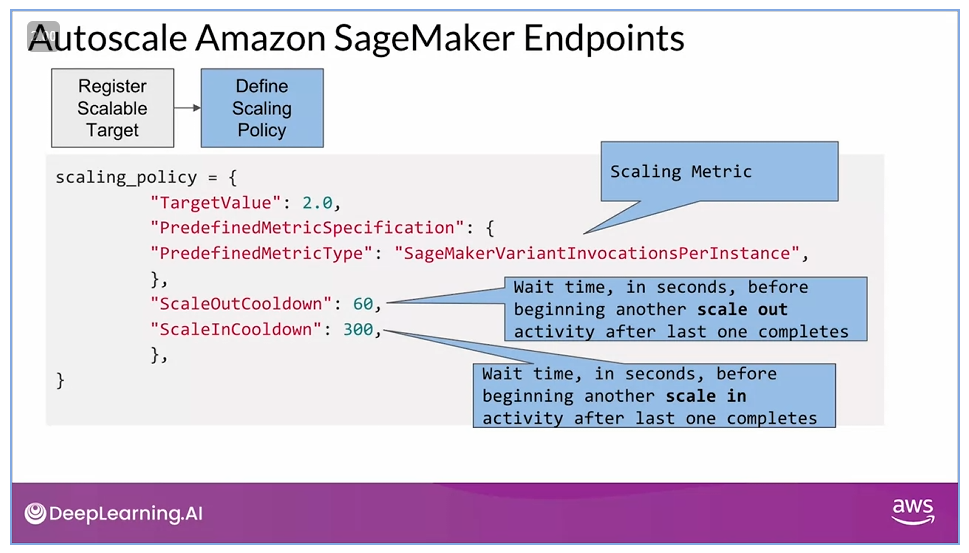

3. **Apply the scaling policy**: `TargetTrackingScaling` refers to the specific autoscaling type that is supported by SageMaker. This uses a scaling metric and a target value as an indicator to scale.

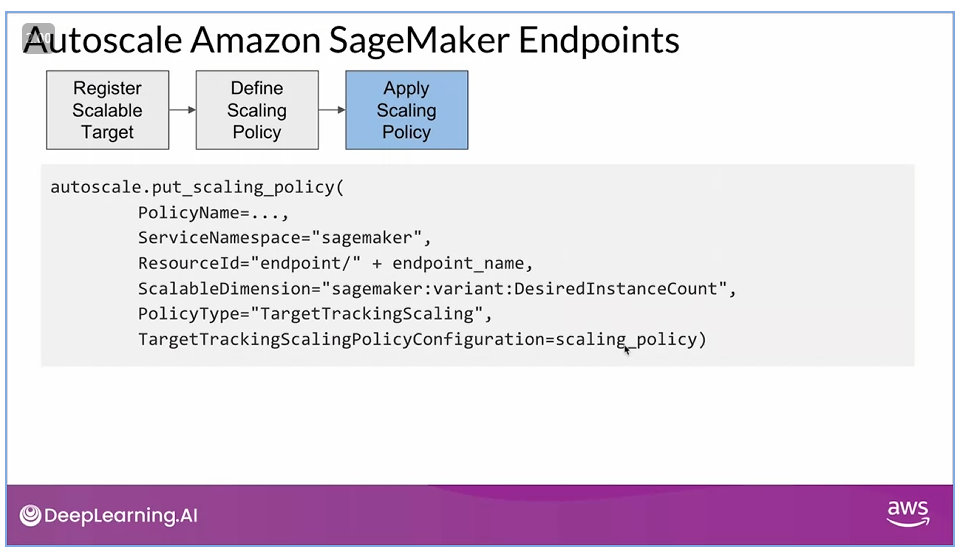

### Multi-Model Endpoints
You can host multiple models behind a single endpoint. Instead of downloading your model from S3 to the machine learning instance immediately when you create the endpoint, with multi-model endpoints SageMaker dynamically loads your models when you invoke them. You invoke then through your client applications by explicitly identifying the model that you're invoking. SageMaker will keep that model loaded until resources are exhausted on the instance. **All of the models hosted on a multi-model endpoint must share the same serving container image**. 

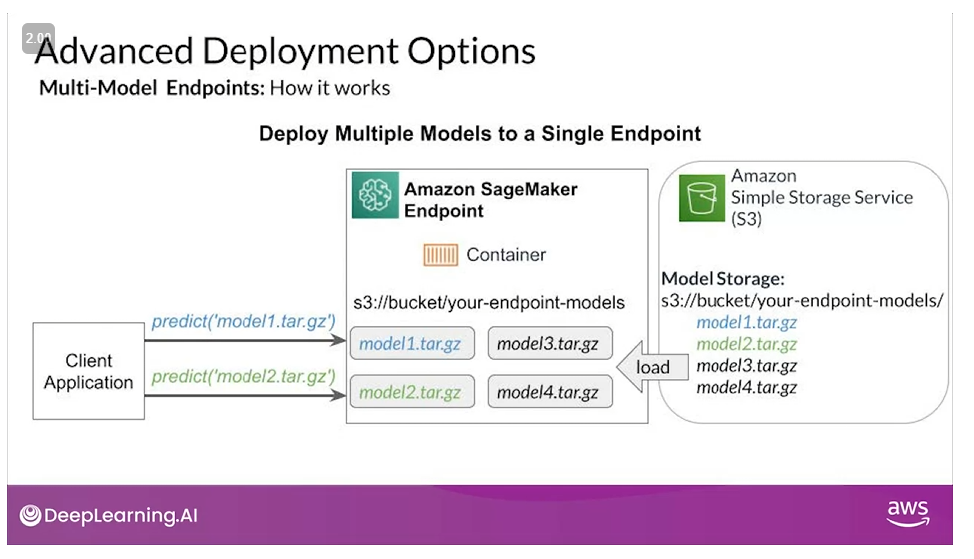

Multi-model endpoints are an option that can improve endpoint utilization when your models are of similar size and share the same container image and have similar invocation latency requirements. 

### Inference Pipeline
**Inference Pipeline** allows you to host multiple models behind a single endpoint. In this case, the models are a sequential chain of models with the steps that are required for inference. This allows you to take your data transformation model, your predictor model, and your post-processing transformer, and host them so they can be sequentially run behind a single endpoint.

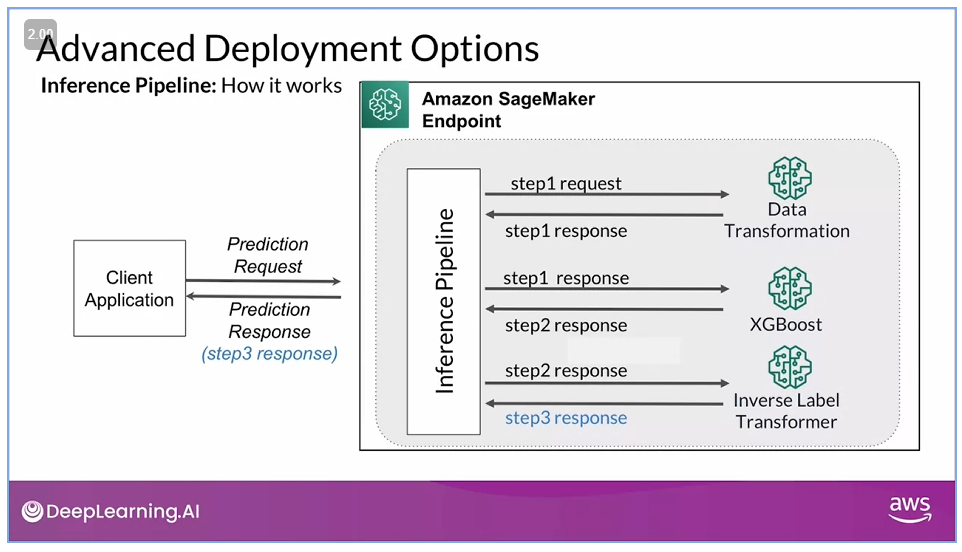



## Amazon SageMaker: Real-Time Inference Production Variants
A **production variant** is a packaged SageMaker model combined with the configuration that defines how that model will be hosted. Remember that the SageMkaer model includes information such as the S3 location of the trained artifacts, the container image that can be sued for inference with that model, and the service run-time role and the model's name. The hosting resources configuration includes information about how you want that model to be hosted (number and type of machine learning instances, a pointer to the SageMaker packaged model, variant name and variant weight).

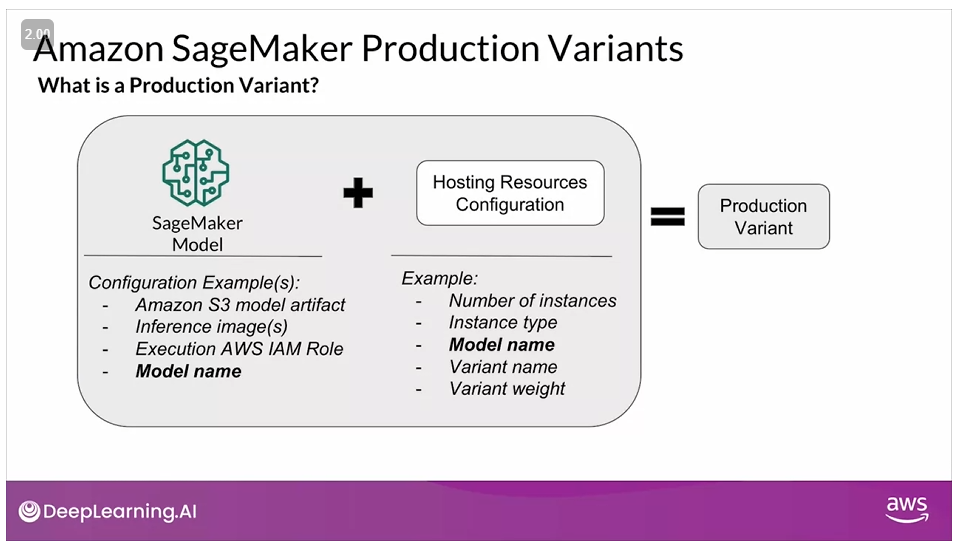

A single SageMaker endpoint can actually include multiple production variants. Production variants can be used for both canary testing and A/B testing, as well as some of the other deployment strategies that we discussed earlier.

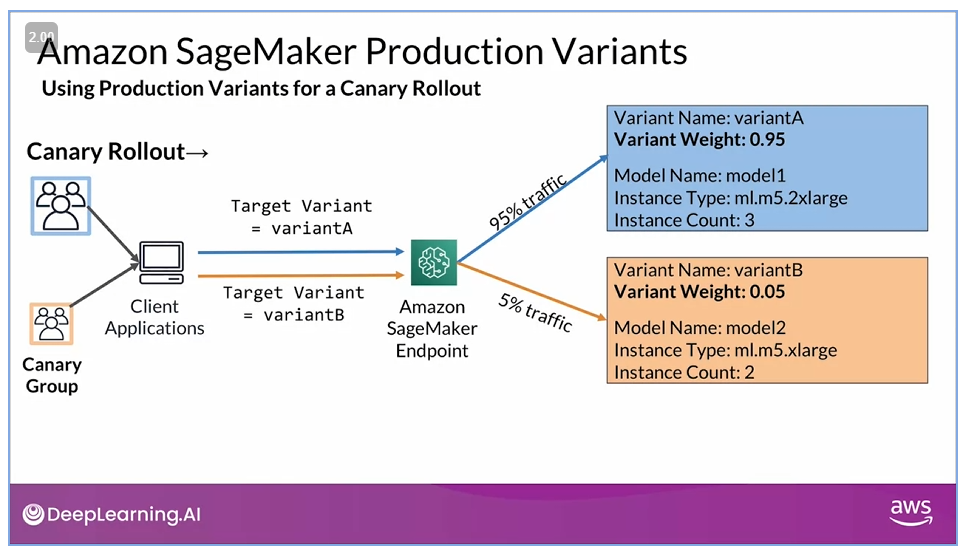

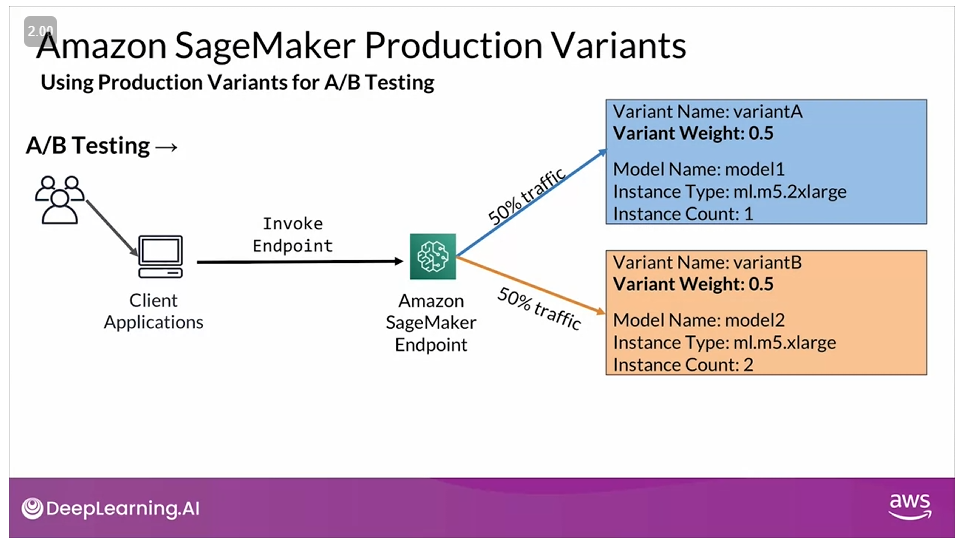

Let's look at the case where you want to use production variants for SageMaker with a pre-built container image.

1. Construct the URI for the pre-build Docker container image.

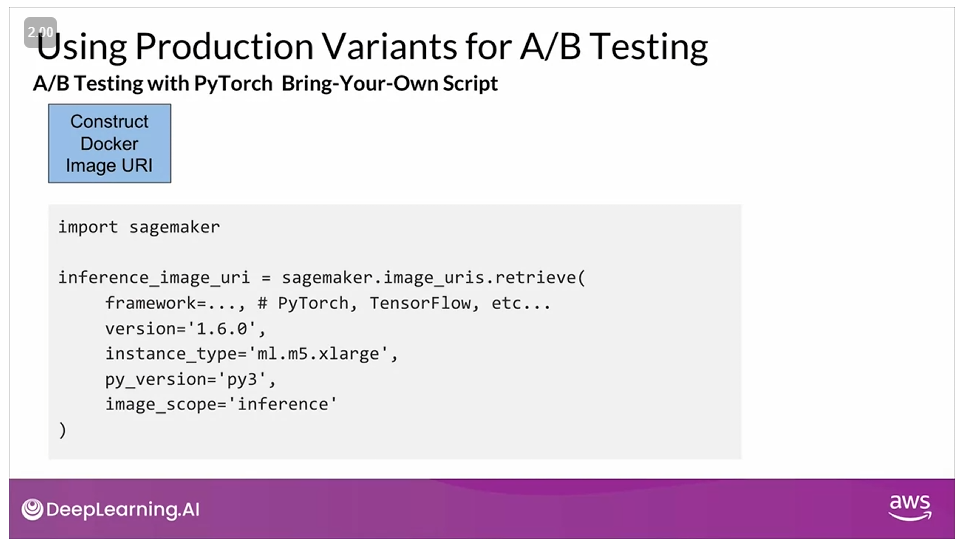

2. Create two model objects, which packages each of your trained models for deployment to a SageMaker endpoint.

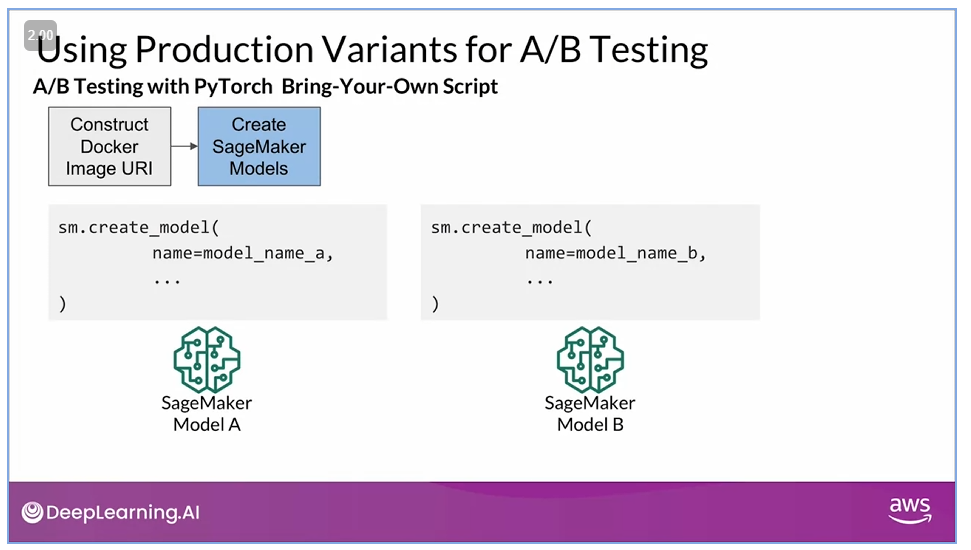

3. Configure the production variants that will be used when you create your endpoint. Each of the variants points to one of the previously configured model packages, and it also includes the hosting resources configuration. Here you can configure the **weight** of the variants.

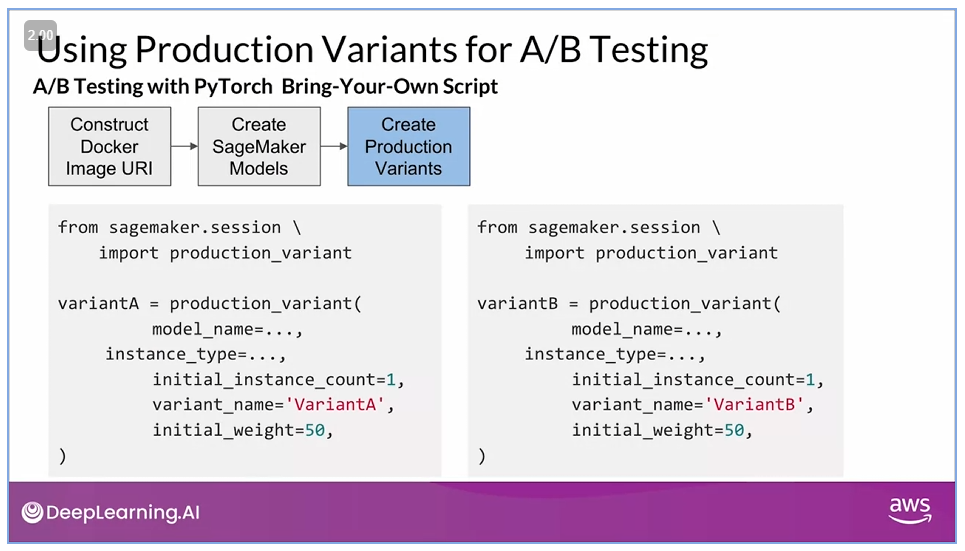

4. Configure the endpoint to use these two variants

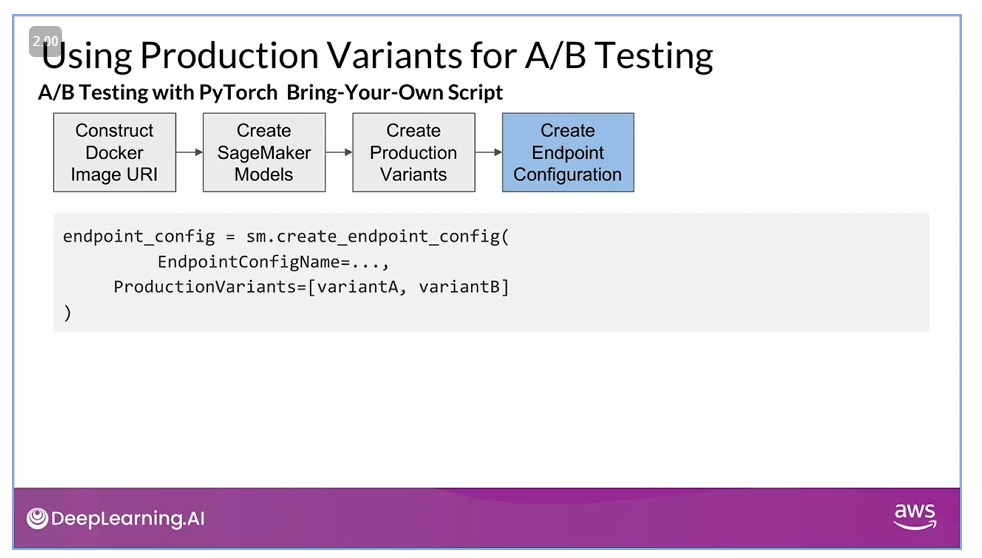

5. Create the endpoint

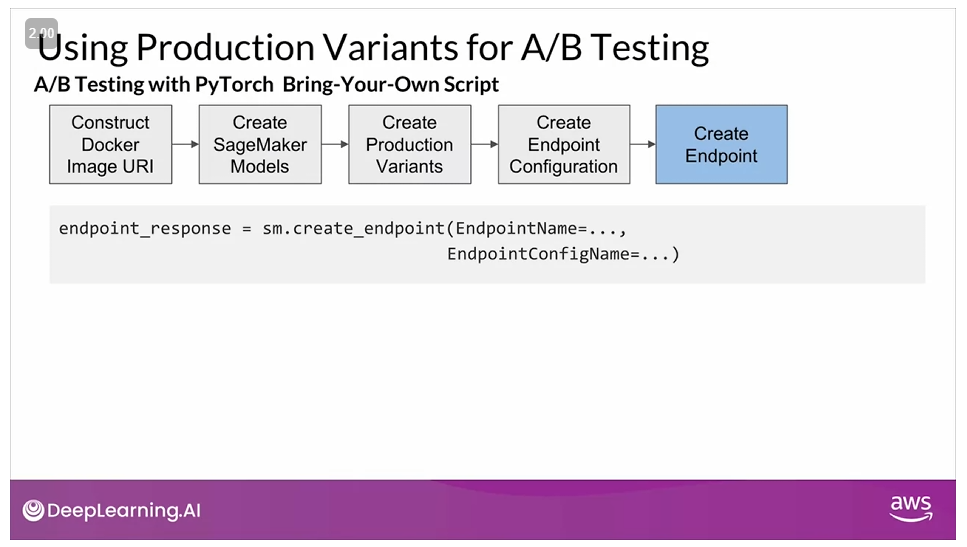


## Amazon SageMaker Batch Transform: Batch Inference
In the labs we see how to make online deployments. However, it is important to know how to implement batch inference use cases using SageMaker **batch transform**. 

1. Package your model: this step is the same whether you're going to deploy your model to a SageMaker endpoint or whether you are going to deploy it for a batch use case.

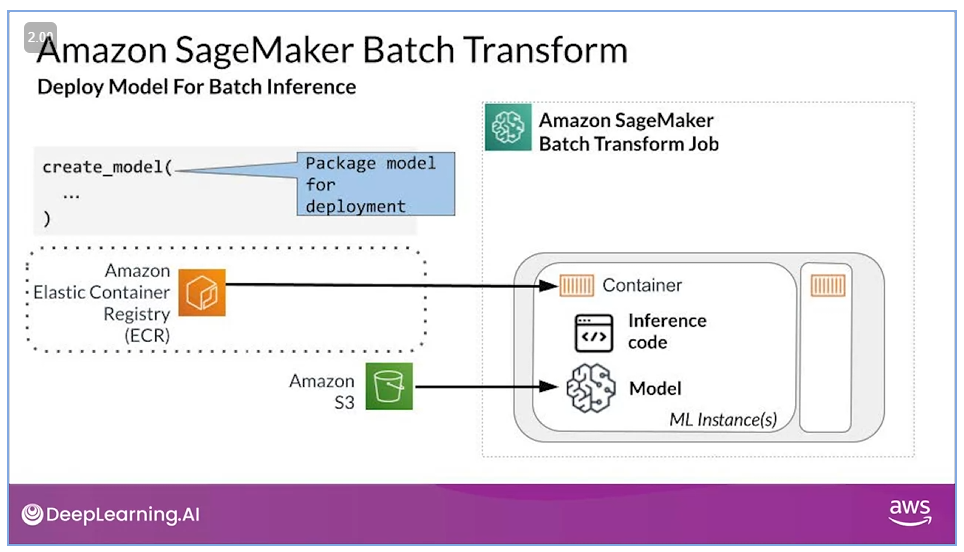

2. Create the transformer

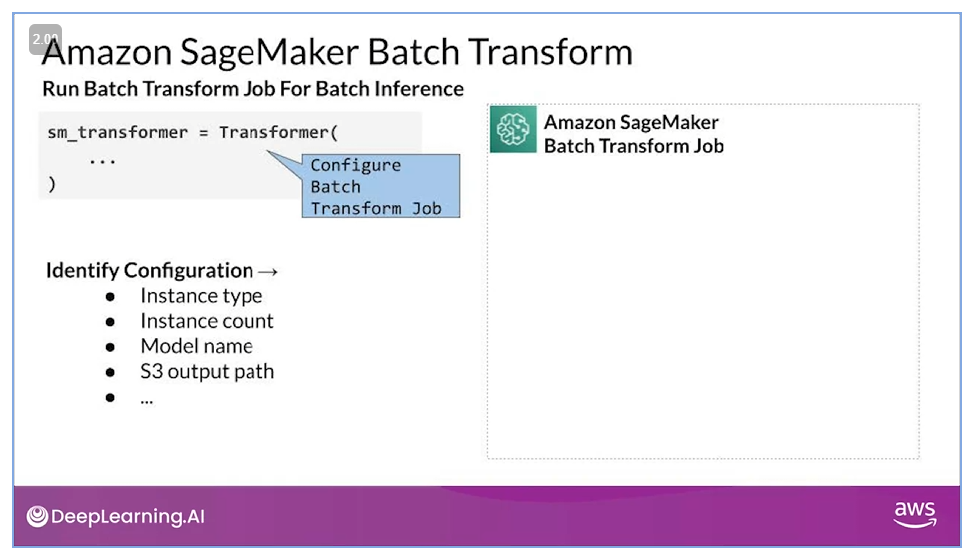

3. Run the batch transform job: this can be done on an ad-hoc basis or by scheduling it. **Batch transform also has more advanced features such as inference pipeline** (seen previously).

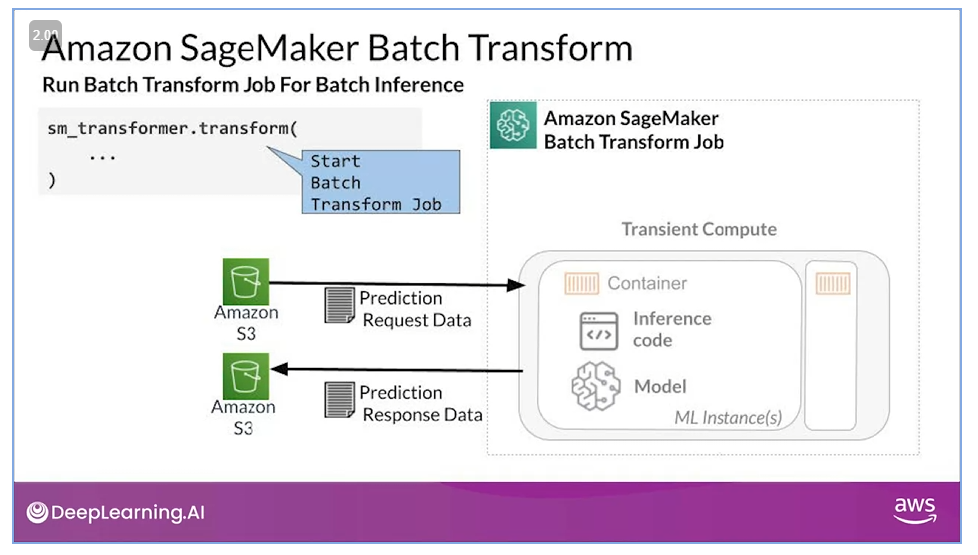



## Model Integration
When you deploy a model to an endpoint, that model is trained using specific features that have been engineered for model performance, and also to ensure that those features are in the required format and are understandable to your machine learning algorithm. These same transformations that were applied to your data for training, need to be applied to your prediction requests that are sent to that same deployed model.

There are different ways to do this. One is to rely on your client application to transform that prediction request data into the correct format before it's actually sent to the endpoint for inference. This would work if your client code always remains synchronized with your training code. However, it's difficult to scale when you have multiple applications or teams that inference with your model. Another consideration is that you may need to transform the output of the model so that's in a format that can be read by the application.

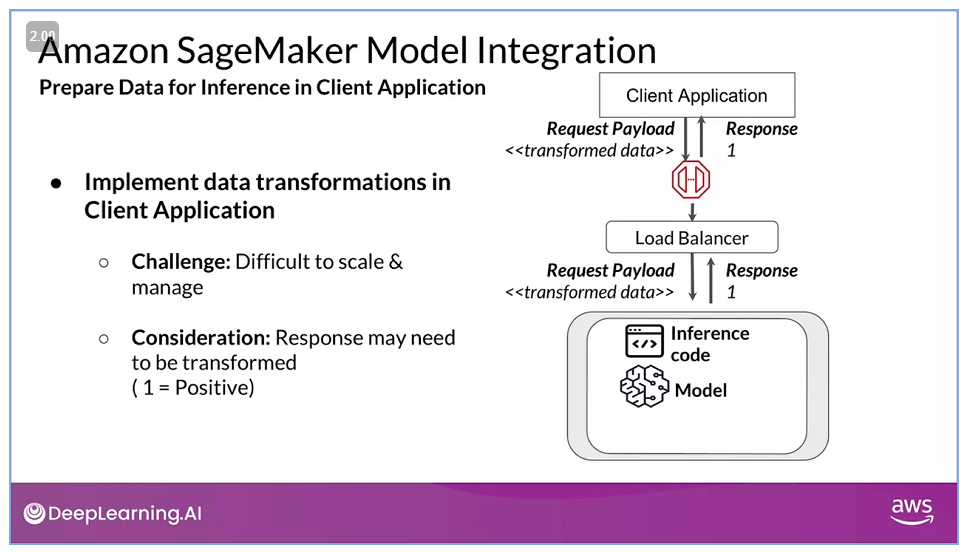

Another option is to implement a back-end function or process that runs before you reach the endpoint, that host your model for prediction. In this case you still need to ensure that your data transformation code or the transformer model that runs before the formatted prediction request is sent to your endpoint always stay synchronized with your trained model.

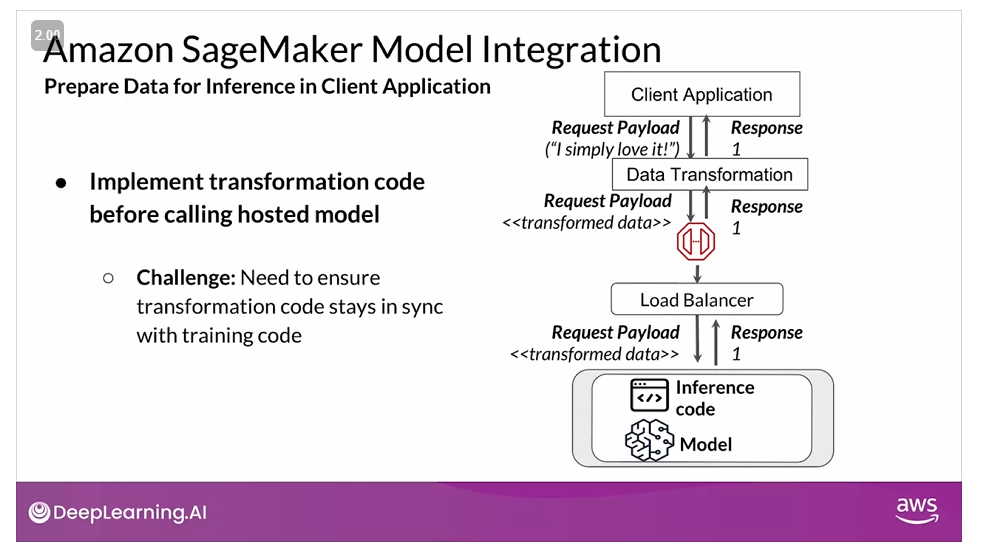

Finally, you can couple your data pre-processing transformers with your model by hosting them behind the same endpoint. In this case, because your data pre-processing is tightly coupled and hosted as well as deployed along with your model, it helps ensure that your training and your inference code stay synchronized, while abstracting the complexity away from the machine learning client applications that integrate your model.

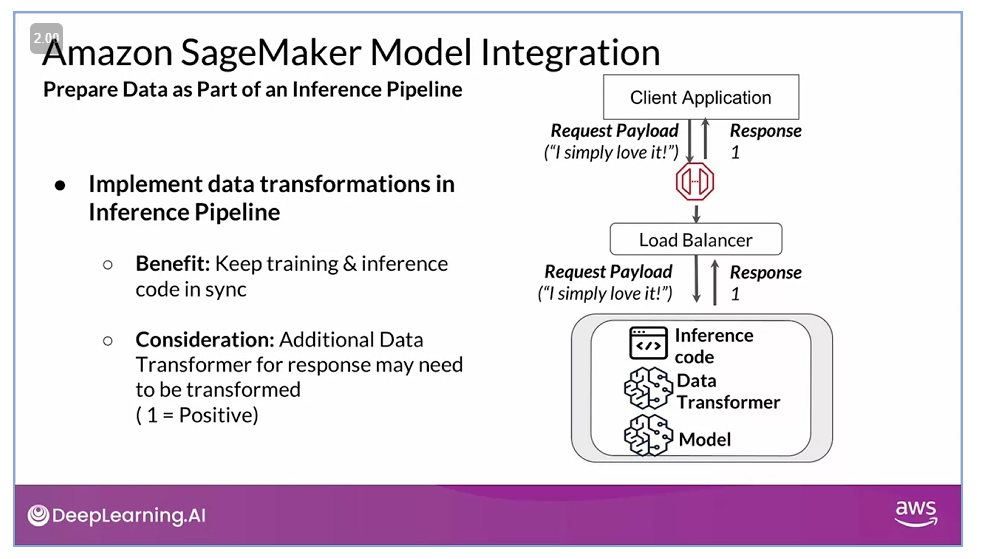

## Monitoring ML Workloads
There are some special considerations when monitoring machine learning workloads. 

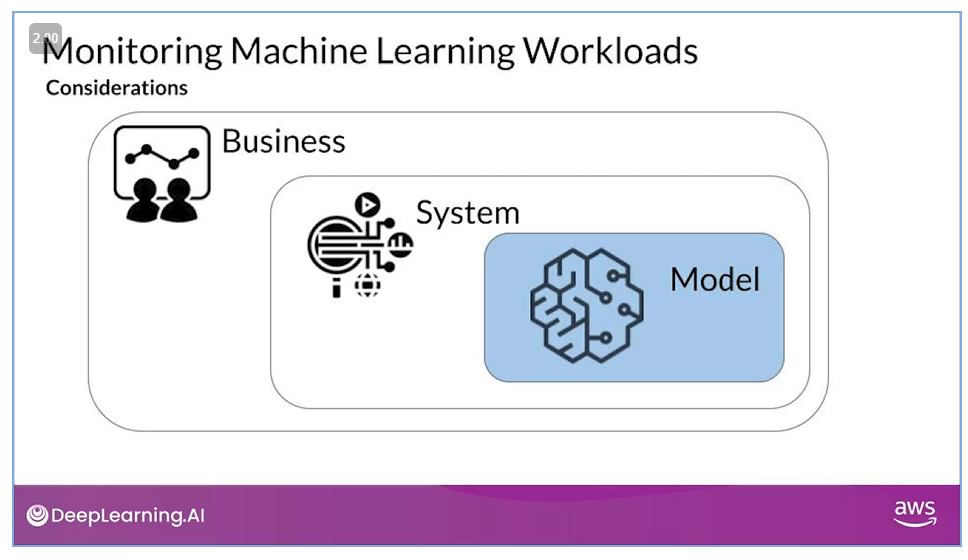

### Monitoring Models
Models decay over time for a number of reasons. Typically it is related to some type of change in the environment where the model was originally trained. The trained models make predictions based on old information or they aren't able to adapt to changes in the environment over time (*e.g.* changes in behavior)

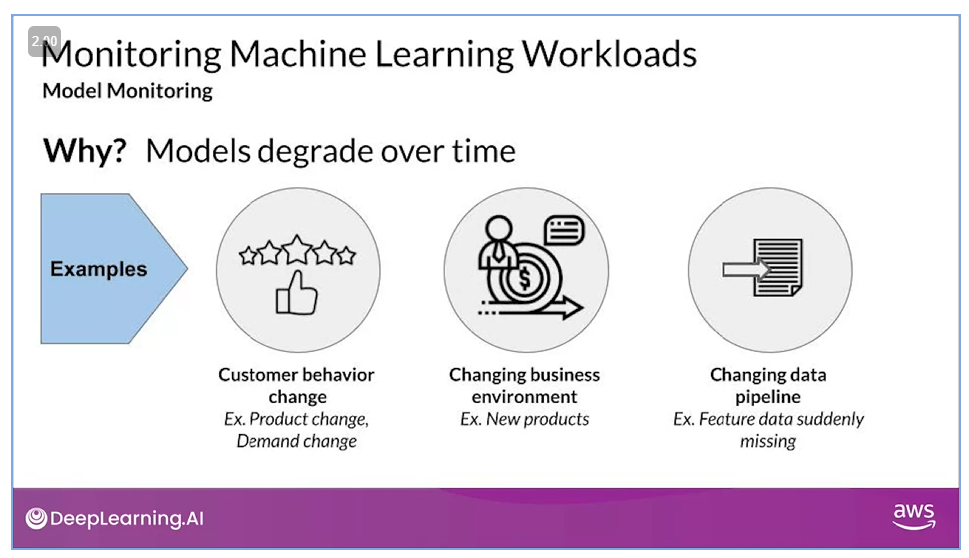

There are two types of monitors when it comes to monitoring machine learning models:

1. **Concept drift**: environment changes that impact the context of the predicted target. In this case, the actual definition of a label changes depending on a particular feature, such as geographical location or age group. 

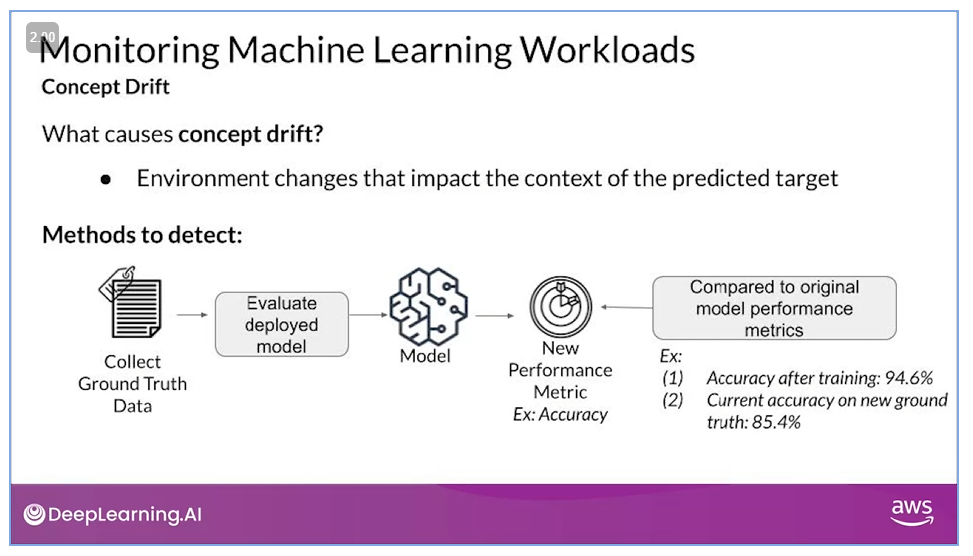

2. **Data drift**: here you see changes in the model input data. You're looking for signals that the serving data has shifted from the original expected data distribution that was actually used for training (*a.k.a.* training serving skew). With the open source library Deequ you perform a few steps to detect signs of data drift.
    1. Do data profiling to gather statistics about each feature that was used to train the model. With this you define the constraints to then identify the boundaries for normal or expected ranges of values for your feature data.
    2. With the data profiling combined with the constraints you can detect anomalies to determine when your data goes out of range from the constraints.
    
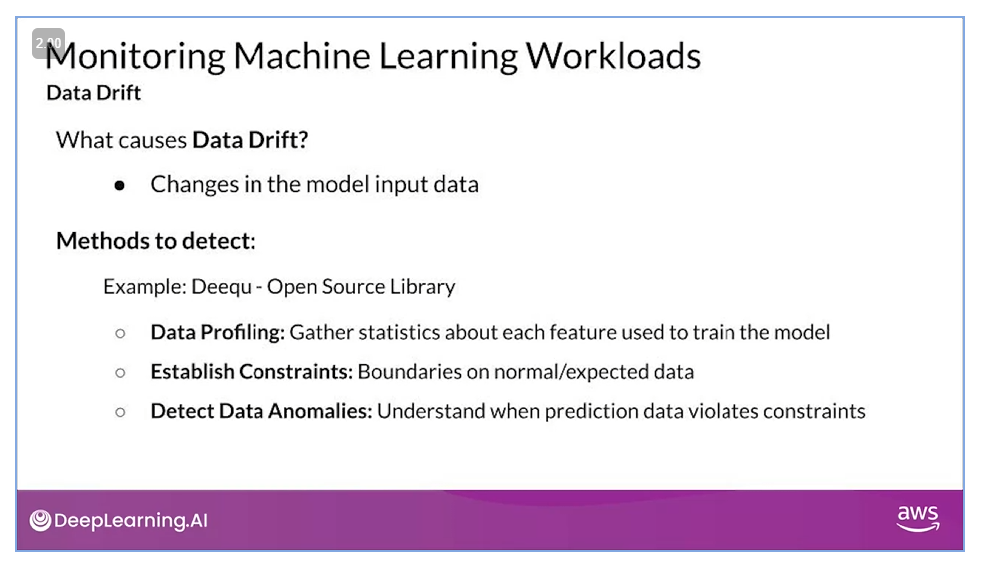

### System Monitoring
**System monitoring** is also key to ensuring your models and the surrounding resources that are supporting your machine learning workloads are monitored for signals of disruption as well as potential performance decline. You want to ensure you include system monitoring so that you can make sure that surrounding and underlying resources that are used to host your model are healthy and functioning as expected. This includes monitoring things like model latency, which is the time it takes for a model to respond to a prediction request. This also includes system metrics for the infrastructure that's hosting your model (*e.g.* CPU utilization).

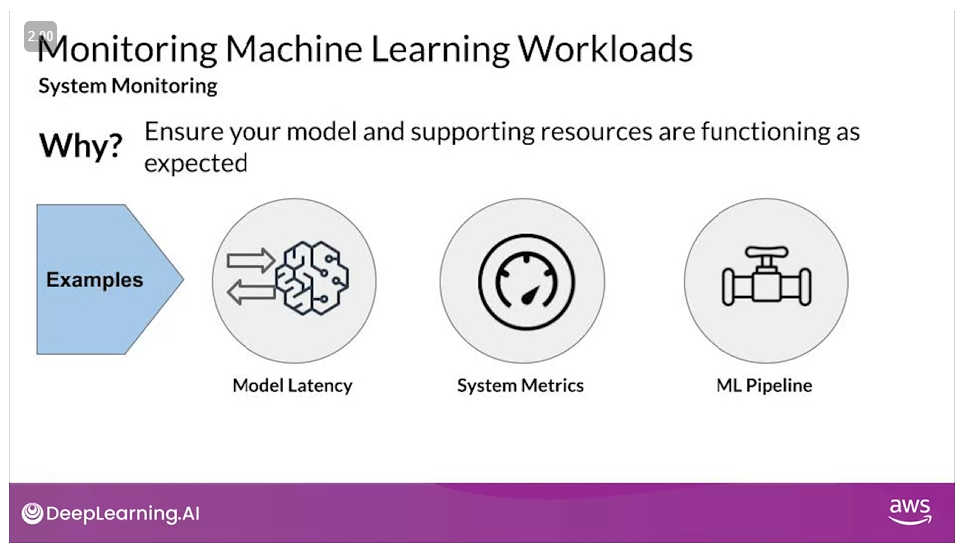

###  Monitoring of Business Impact
Here you're looking at ensuring your deployed model is actually accomplishing what you intend for it to do, which ties back to the impact to your business objectives.

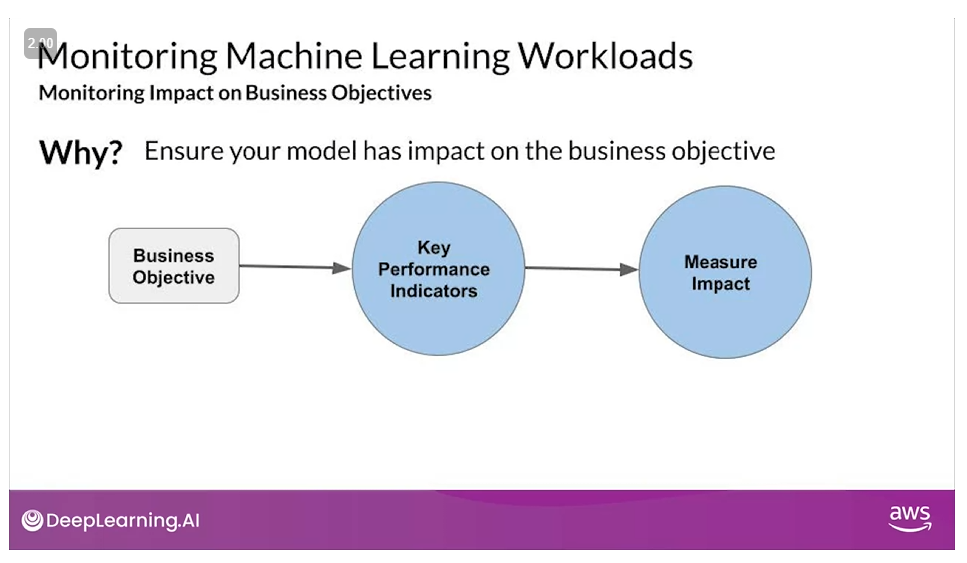


## Model Monitoring using Amazon SageMaker Model Monitor
**Model Monitor** includes 4 different monitor types:

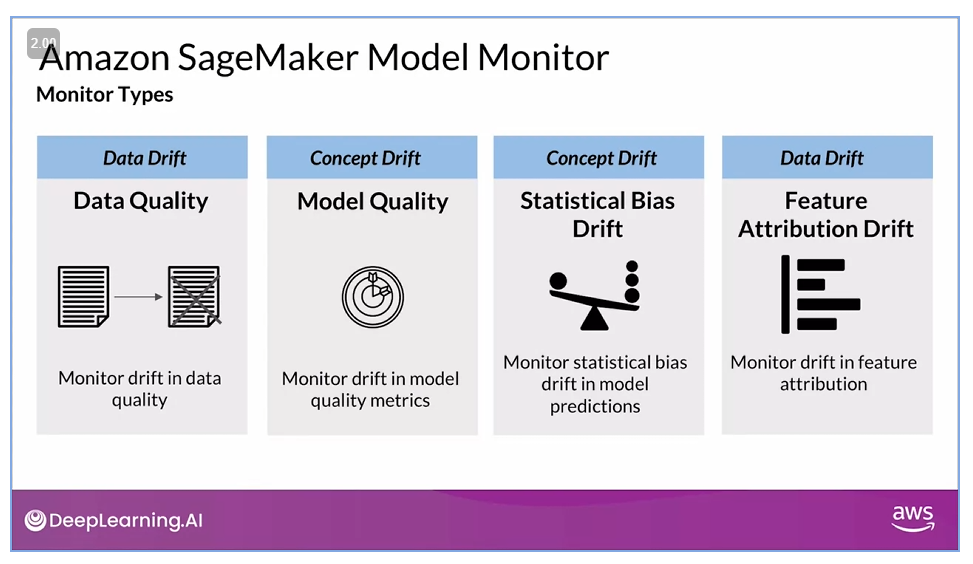

### Data Drift (Data Quality)
You're monitoring for signals that the feature data that was used to train your models has now drifted or is statistically different from the current data that's coming in for inference. Model Monitor uses `Deequ`, an open source library build on Apache Spark (generate data profiling, constraints based on the profiling and detect anomalies when data goes out of bounds from the expected values or constraints).

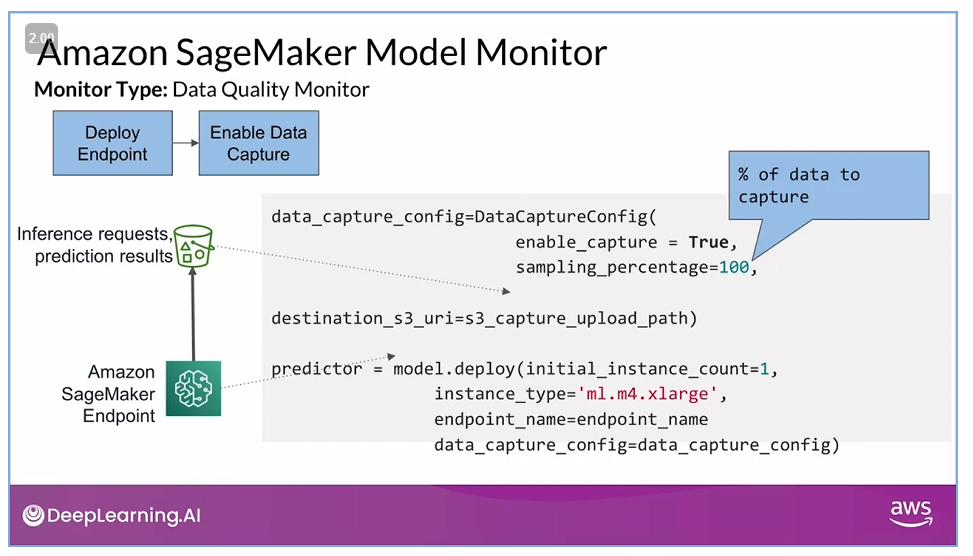

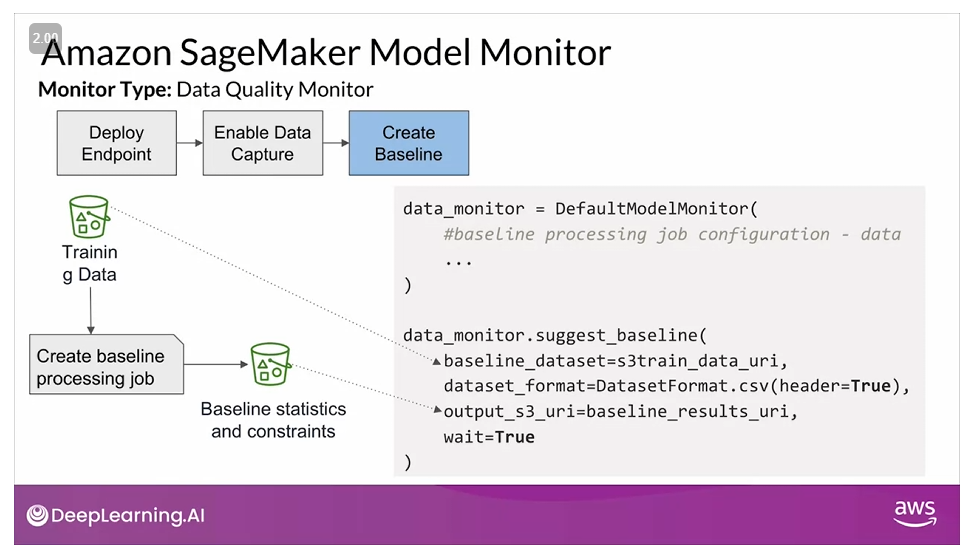

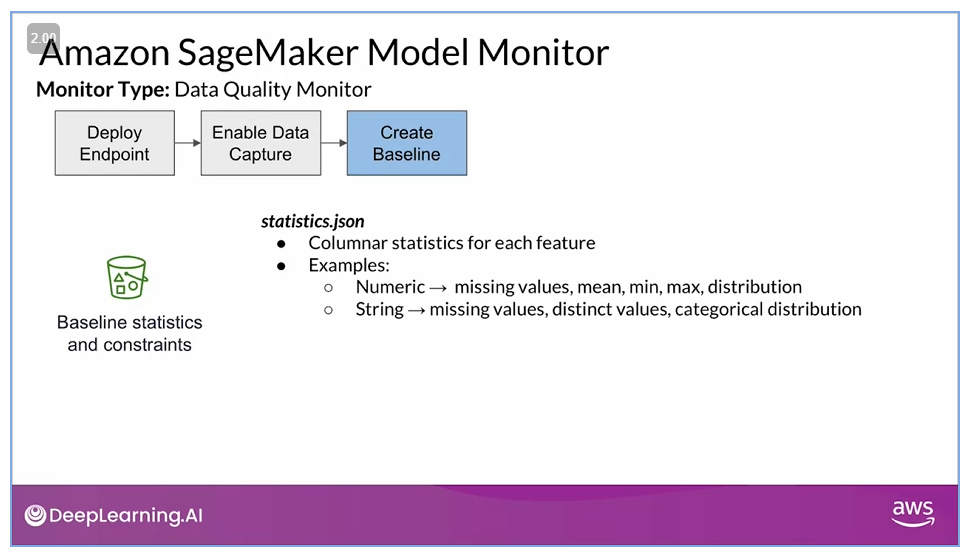

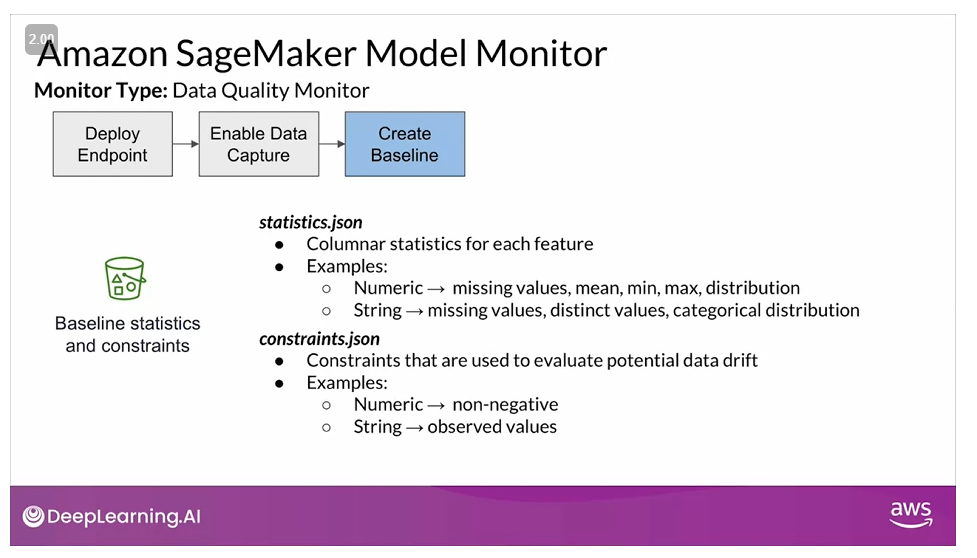

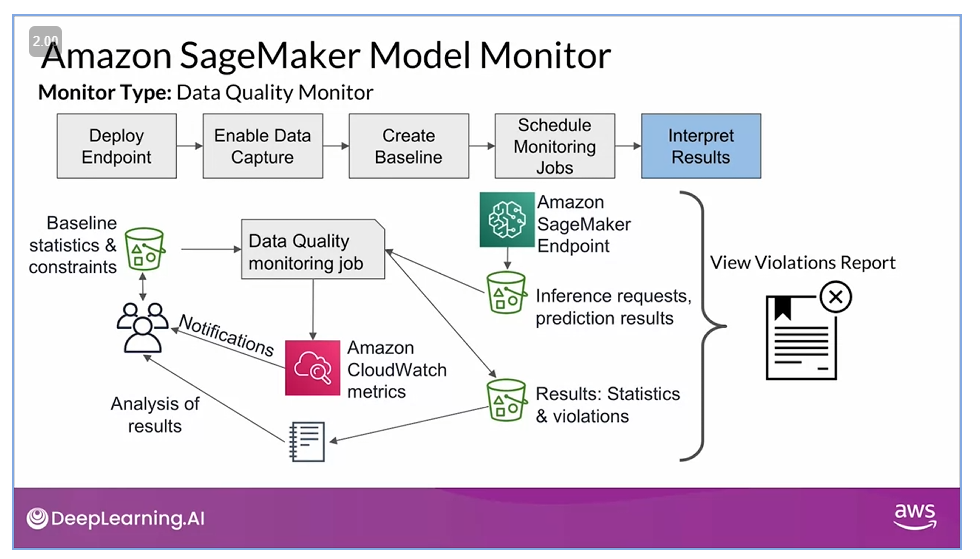

### Concept Drift (Model Quality)
You're using new ground truth data that is collected to evaluate against your deployed model for signs of concept drift. Here you use the new labeled data to evaluate your model against the performance metric that you've optimized for during training. You the compare the new accuracy value to the one you identify during model training to see if your accuracy or metric is potentially going down.

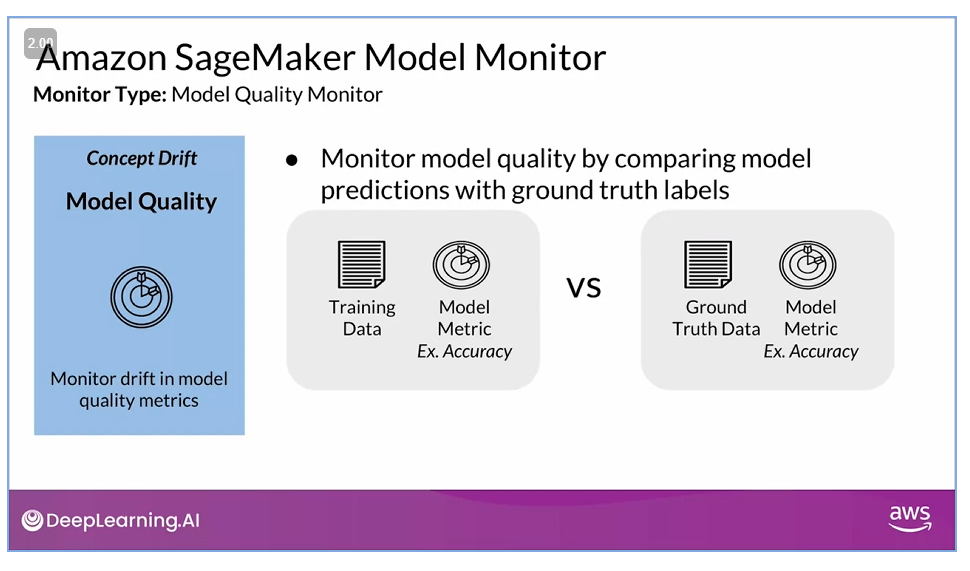

### Concept Drift (Statistical Bias Drift)
You monitor predictions for statistical bias. This is done by integrating with SageMaker Clarify. The process to setup is similar to what we saw before.

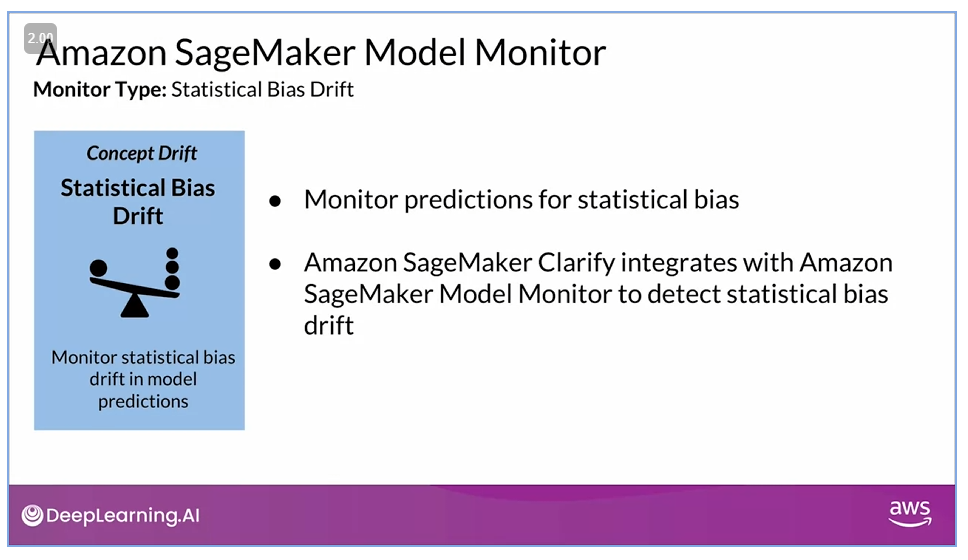

### Data Drift (Feature Attribution Drift)
Monitors for drift in your features. For this Model Monitor monitors for drift by comparing how the ranking of individual features changed from the training data to the live data. This helps explain model predictions over time. The baseline job in this case uses SHAP behind the scenes, which is commonly used to explain the output of a machine learning model.

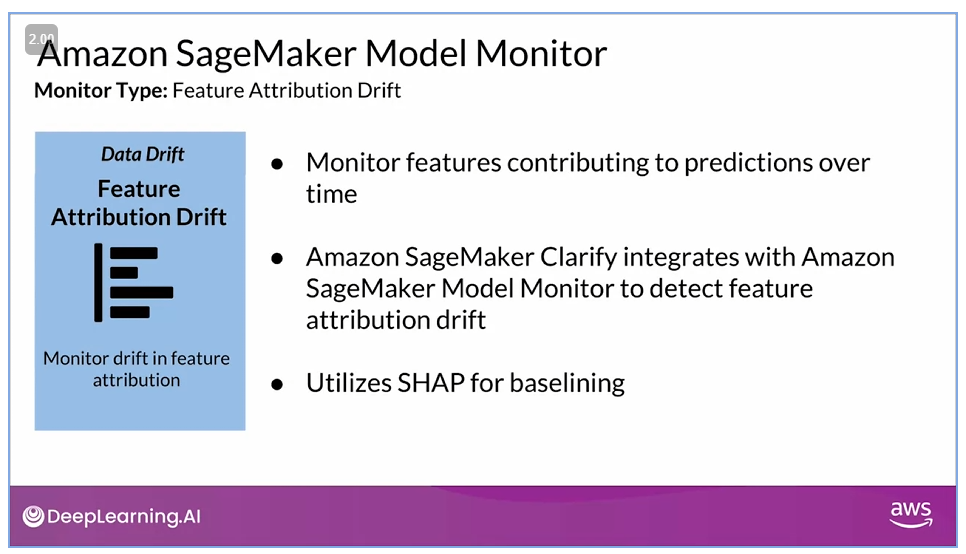

# **Week 3**: Data Labeling and Human-in-the-Loop Pipelines
***

## Data Labeling
Prior to building training and deploying machine learning models, you need data. Successful models are built on high quality training data. But collecting and labeling the training datasets involves a lot of time and effort. To build training datasets you need to evaluate and label a large number of data samples. These labeling tasks are usually distributed across more than only one person, adding significant overhead and cost. If there are incorrect labels, the system will learn from the bad information and make inaccurate predictions. 

A variety of studies have shown that the majority of data scientist's time is spent on data preparation tasks such as finding, cleaning, and labeling data, and only about 20% of time is spent on developing,training and tuning the model. 

In machine learning, **data labeling** is the process of identifying raw data such as images, text files, and videos, among others, and adding one or more meaningful and informative labels to the data. Labels provide context so that the machine learning models can learn from it. Today, mos practical machine learning models utilize *supervised learning*. For supervised learning to work, you need a label set of data that the model can learn from, so it can make the correct decisions. In ML, a properly labeled dataset that you use as the objective standard to train and assess a given model is often called the ground truth. The accuracy of your trained model will depend on the accuracy of your ground truth.

### Common Types of Data Labeling
1. Computer vision:
    + Bounding box: create a border that fully encloses a digital image known as a **bounding box** to generate your training dataset.
    + Image/video classification: you can have single-label classification or multi-label classification (when you have multiple objects of interest in the image content)
    + Semantic segmentation: in this method we identify all pixels that fall under a given label and usually involves applying colored filter or mask over those pixels.
    
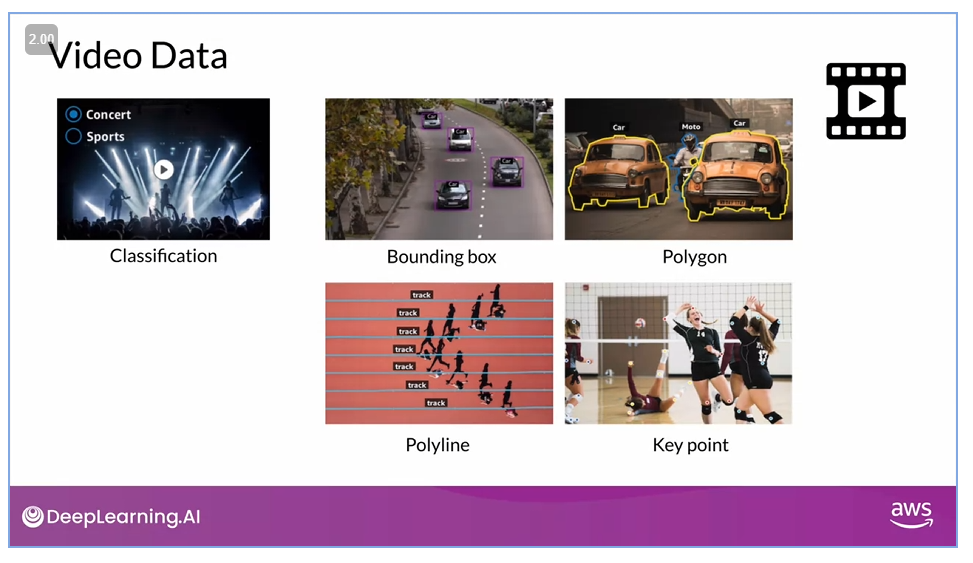

2. Natural language processing
    + Classification: you can also have single-label classification (*e.g.* sentiment classification) or multi-label classification (*e.g.* topics)
    + Named entity recognition: you apply labels to words within a larger text (*e.g.* to identify places or people)
    
### Challenges
The biggest challenge in data labeling is the **massive scale**. Machine learning models need large labeled datasets. This could be tens of thousands of images to train a computer vision model of thousands or documents to fine tune a natural language processing  model.

The second challenge is the need for **high accuracy**. Machine learning models depend on accurately labeled data. If there are incorrect labels the system will learn from the bad information and make inaccurate predictions.

The third challenge is **time**. Data labeling is tome consuming. Building a training dataset can take up to 80% of the data scientists time, so we need to build an efficient data labeling process.

To address these challenges, you can combine human labelers with managed data labeling services. These data labeling services provide additional tools to scale the labeling efforts for access to additional human workforces. Train a model based on human feedback, so it can perform automated data labeling. Increase the labeling quality by offering additional features to assist the human labelers. 

## Data Labeling with Amazon SageMaker Ground Truth
**Ground Truth** provides a managed experience where you can setup an entire data labeling job with only a few steps. It helps you efficiently perform highly accurate data labeling using data stored in Amazon S3, using a combination of automated data labeling and human performed labeling. You can choose to use a crowd-sourced Amazon Mechanical Turk workforce of over 500,000 labelers, a private team of co-workers, or one of the third-party data labeling service providers listed on the AWS marketplace, which are pre-screened by Amazon.

It is very easy to create a data labeling job and it takes only minutes via the AWS management console or call to an API.

1. Provide a pointer to the S3 bucket that contains the input dataset to be labeled
2. Define the labeling task and provide relevant labeling instructions. Ground Truth offers templates for common labeling tasks, where you need to click only a few choices and provide minimal instructions on how to get your data labeled. Alternatively, you can create your own custom template. 
3. Select a human workforce. You can choose between a public crowdsourced workforce, a curated set off third-party data labeling service providers, or your own workers through a private workforce team.

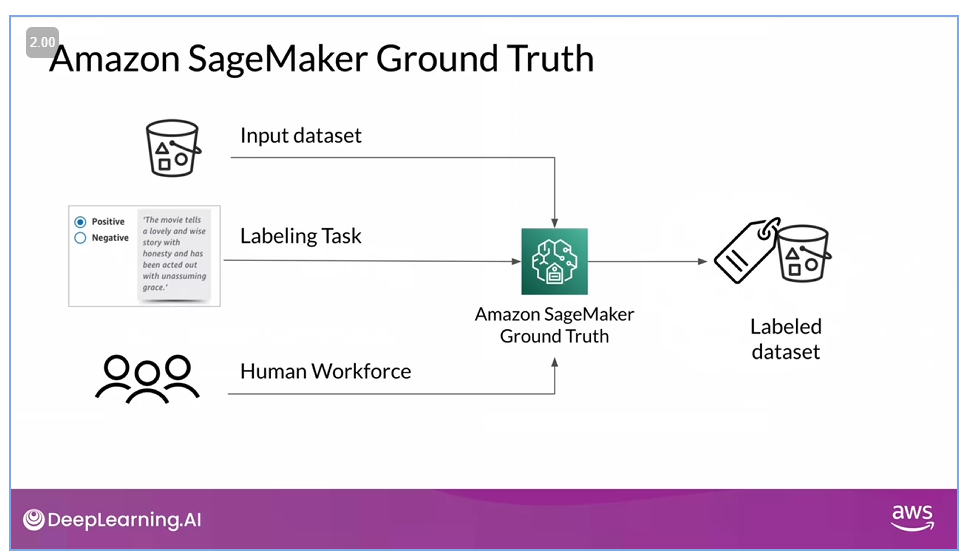

Once the labeling process is completed, you can find your labeled data in S3. Let's see the individual steps:

1. **Setup Input Data**: you have an automated data setup (only needs a S3 location of the dataset to be labeled; the manifest file, which identifies the objects to be labeled, is generated automatically) and a manual data setup you provide your own manifest file (contains the list of objects to be labeled), where each line in the file is a complete and valid JSON object and contains either a source-ref or source JSON key. The source-ref value points to the S3 object to label. This approach is commonly used for binary objects, such as images in your S3 bucket. The source-key is used if the object to label is text. In this case you can state the text directly as the value in the manifest file.

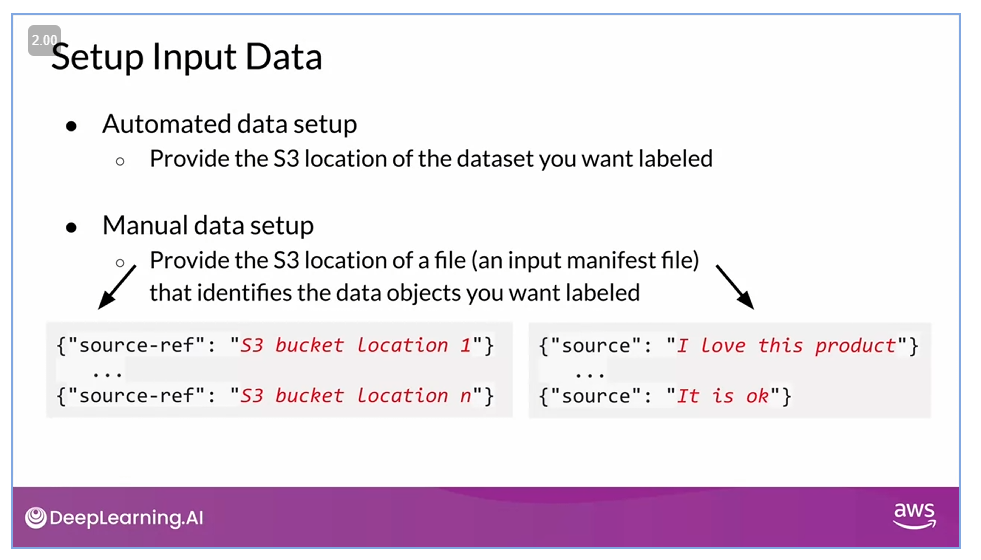

2. **Select Labeling Task**: this defines the type of data that needs to be labeled. Ground Truth has several built-in task types which also come with a corresponding pre-built worker task templates. As part of the custom labeling task, you create custom AWS Lambda functions. They run before and after each data object is sent to the worker.

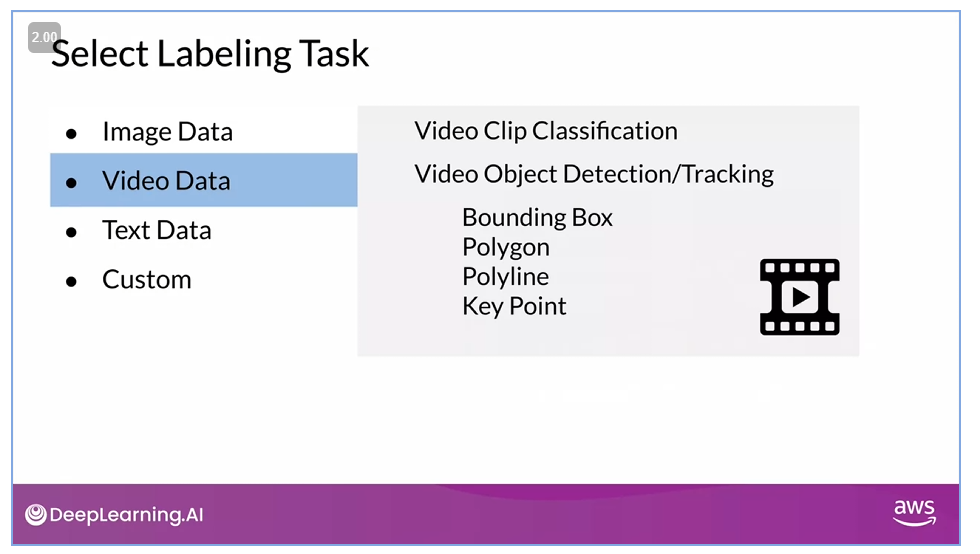

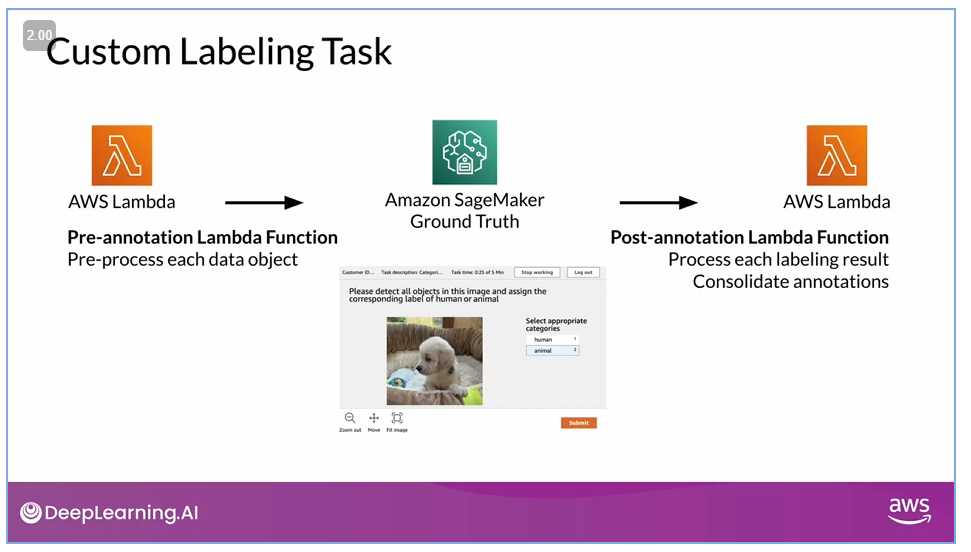

3. **Select Human Workforce**

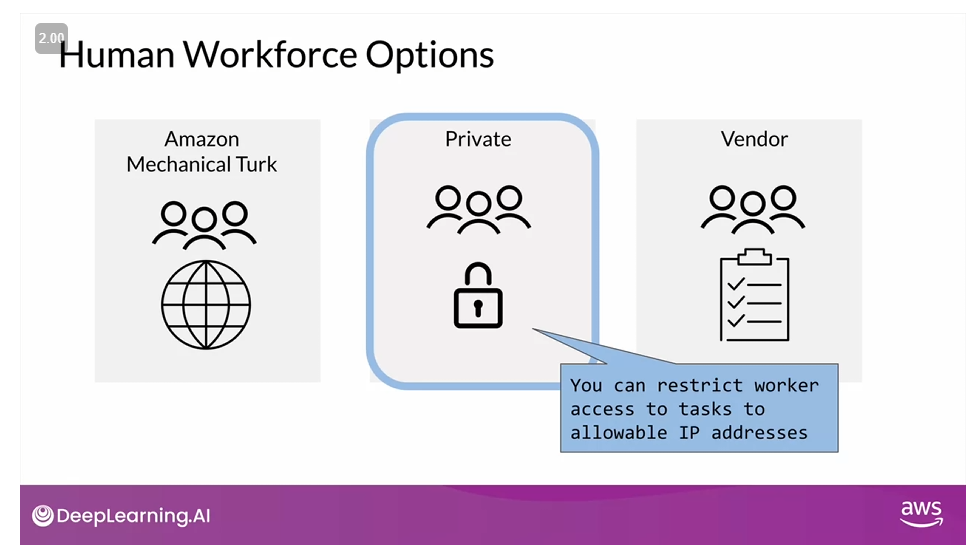

4. **Create Task UI**: you present the human labeler with a data to label and the labeling instructions. The human task UI is defined as a HTML template. You can use a pre-defined task template and customize to your needs; you can also write a custom task template (using HTML, CSS, JS, Liquid tempalte)

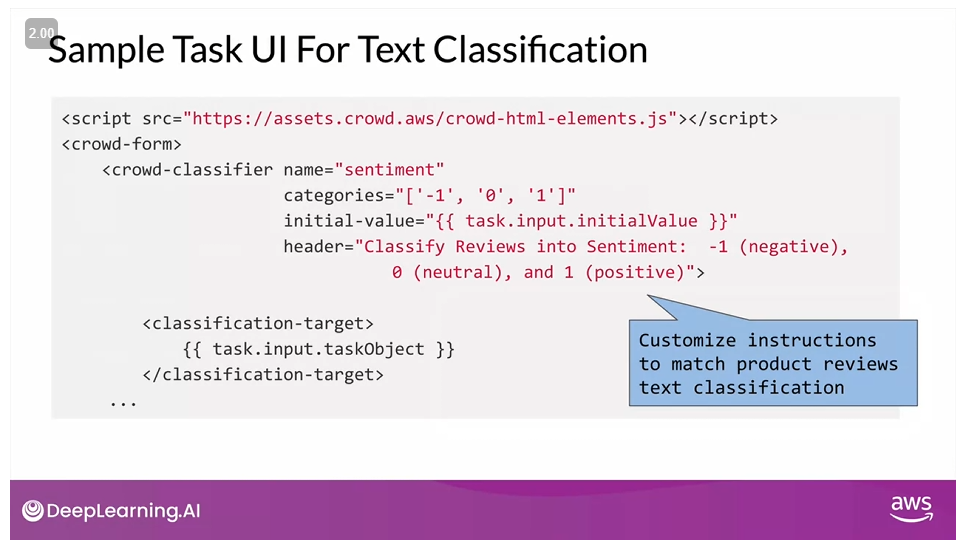

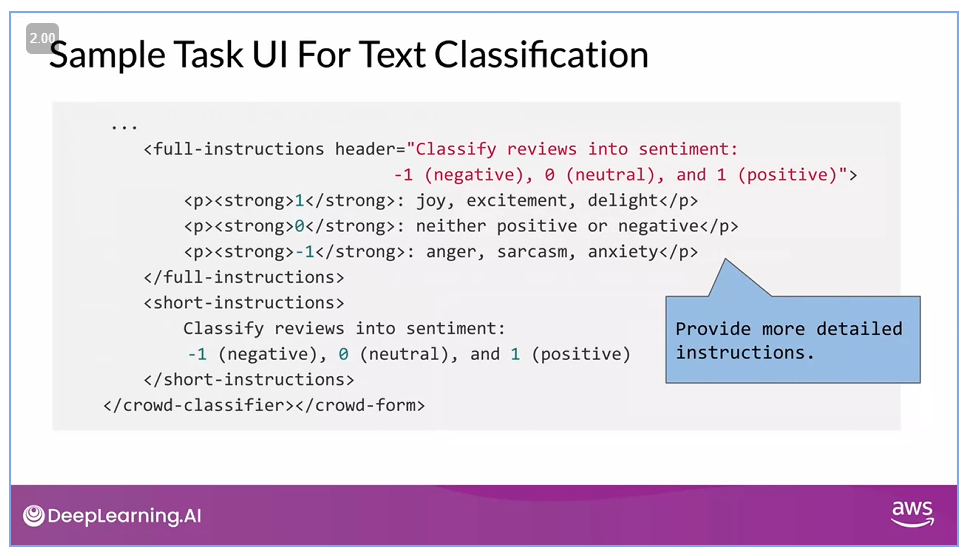

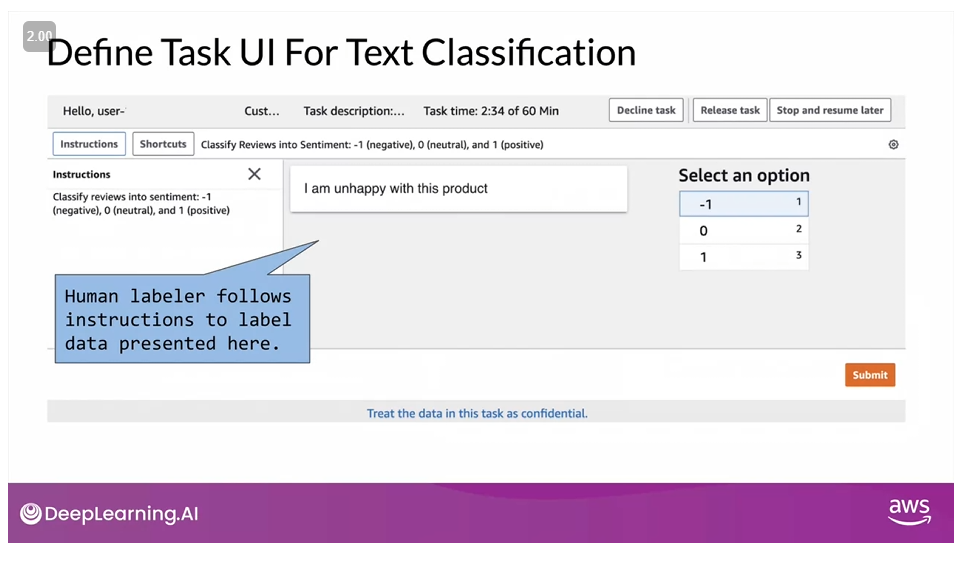

## Data Labeling Best Practices

### Provide Clear Instructions
Communicate with the labelers through labeling instructions and make them clear to help ensure high accuracy.

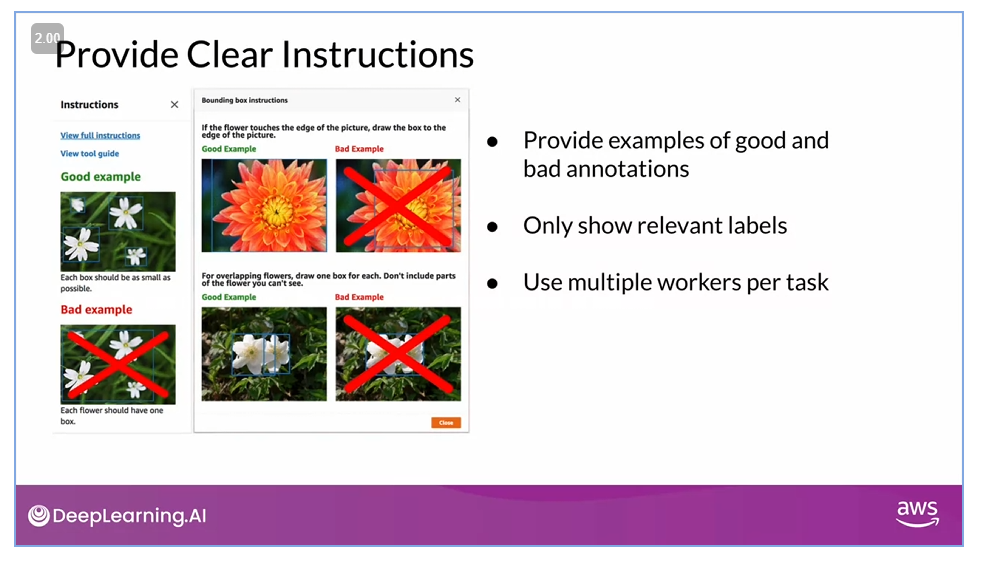

### Consolidate Annotations to Improve Label Quality
Labeler consensus helps to counteract the error of individual annotators. Labeler consensus involves sending each dataset object to multiple annotators and then consolidating the annotations into a single label.

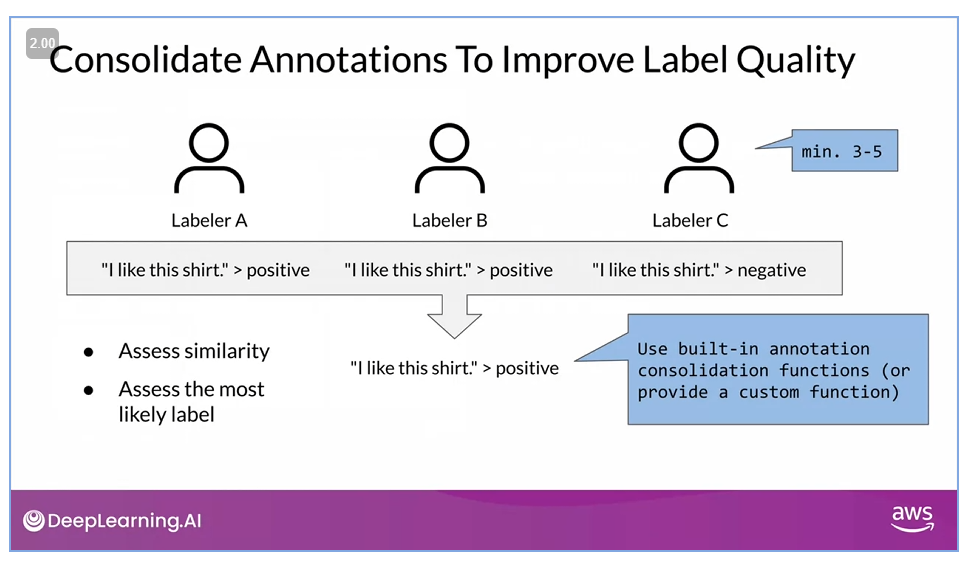



### Verify and Adjust Labels

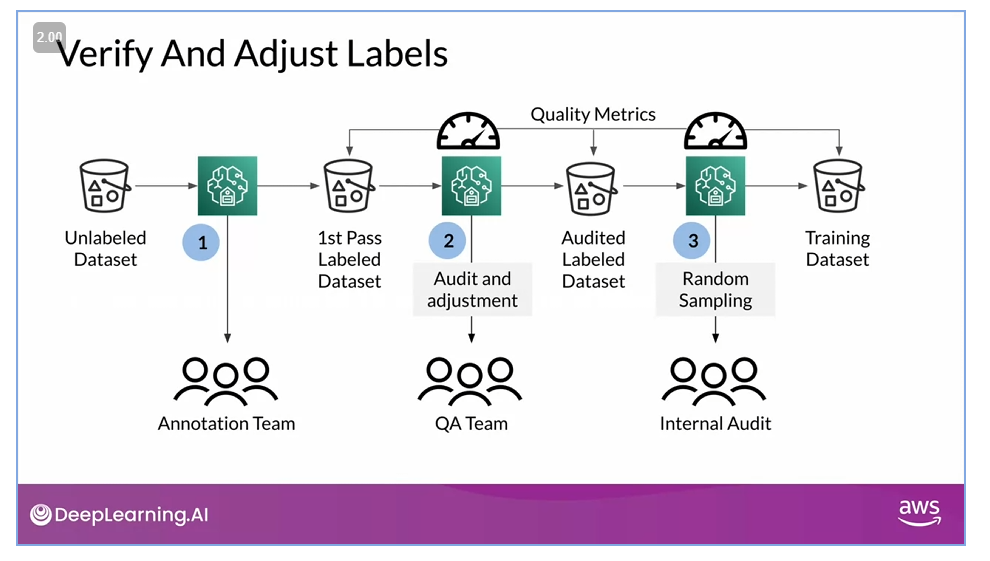


### Use Automated data labeling on large datasets (Active Learning)
**Active learning** is the machine learning technique that identifies data that should be labeled by workers. In *Ground Truth* this functionality is called Automated Data Labeling. It helps to reduce the cost and time that it takes to label your dataset compared to using only humans. It is most appropriate when you have thousands of data objects. The minimum number of objects allowed for automated data labeling is 1250, but it's better to start with 5000 objects.

When you choose automated data labeling, part of your dataset is labeled using active learning. In this process a ML model for labeling data is first trained on a subset of your raw data that humans have labeled. Where the labeling model has high confidence in its results based on what it has learned so far, it will automatically apply labels to the raw data. Where the labeling model has lower confidence, it will pass the data to humans to do the labeling. The human generated labels are then provided back to the labeling model for it to learn and improve its ability to automatically label the next set of raw data. Over time, the model can label more and more data automatically and substantially speed up the creation of training datasets.

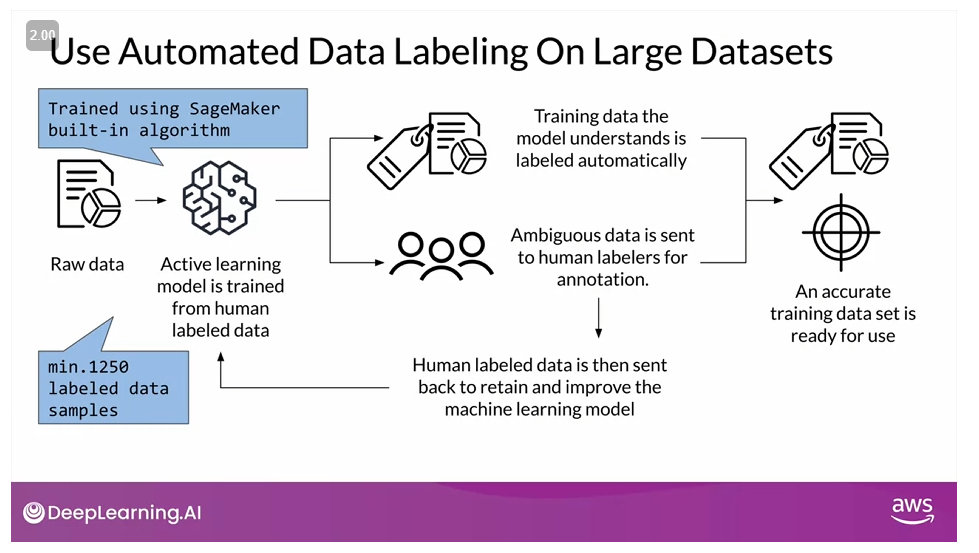


### Re-use prior labeling jobs to create hierarchical labels
This chaining of labeling jobs allows you to use the prior jobs output manifest file as the new jobs input manifest. For example, a first data labeling job could classify objects in an image into cats and dogs. In a second labeling job you filter the images that contain a dog and add additional labels for the specific dog breed. The result of the second labeling job is an augmented manifest file (*augmented* refers to the fact that the manifest file contains the labels from both labeling jobs).

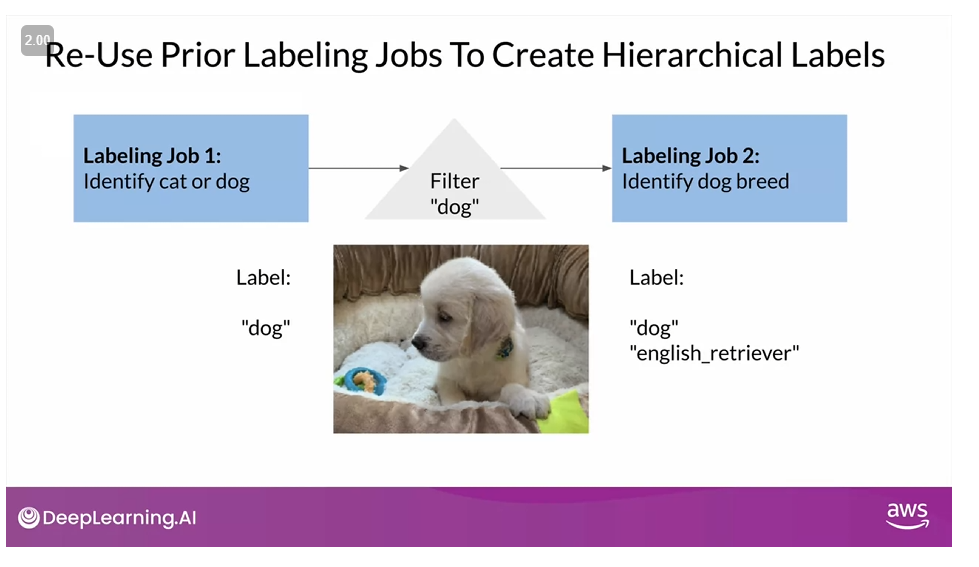



## Human-In-The-Loop Pipelines
Some machine learning applications need human oversight to ensure accuracy with sensitive data to help provide continuous improvements and retrain models with updated predictions. However, in these situations, you're often forced to choose between a ML only or human only system. If you want the best of botch worlds, integrating ML systems into your workflow while keeping a human eye on the results to provide a required level of precision, you will use **human-in-the-loop** pipelines.

You can allow human reviewers to step in when a model is unable to make a high confidence prediction, or to audit its prediction an ongoing basis. One example is image-label review, or review form extraction tasks (*i.e.* extracting  information from scanned employment or mortgage application forms).

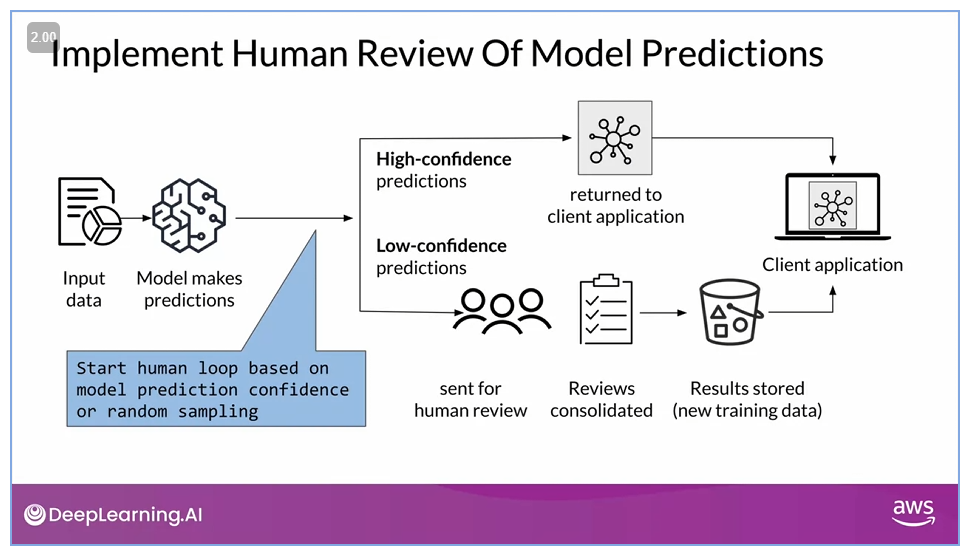

When there's a human review correction you should store the reviewed prediction results and make it available to retrain the model, so it can improve over time. Note that the confidence threshold value that decides whether to start a human in the loop will depend on your use case and requirements. You could decide to use human review based on threshold or random sampling.

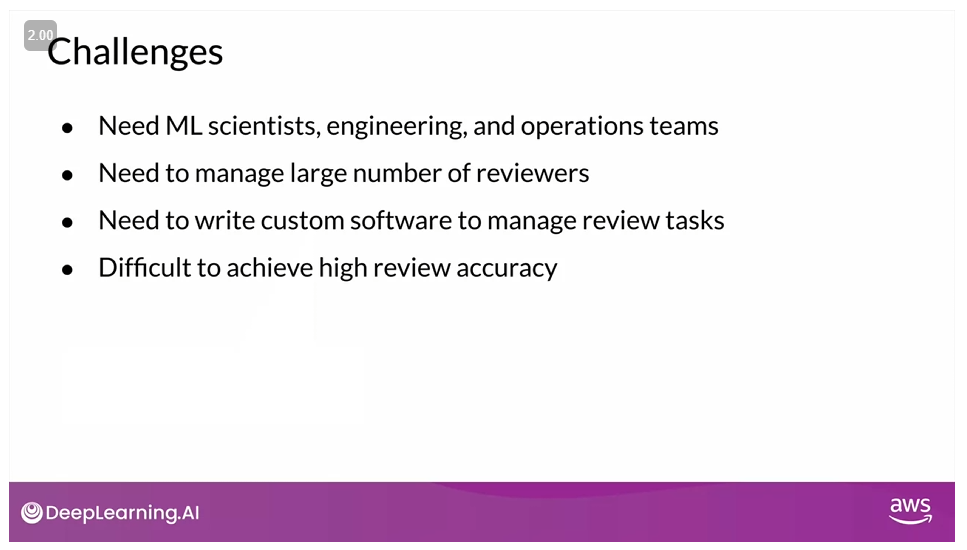

## Human-In-The-Loop Pipelines with Amazon Augmented AI (Amazon A2I)
Amazon A2I makes it easy to build and manage human reviews for machine learning applications. It provides built-in human review workflows for common machine learning use cases such as text extractions from documents. You can also create your own workflows for machine learning models built on SageMaker or any other tools. Using Amazon A2I, you can allow human reviewers to step in when a model is unable to make a high confidence prediction or to audit its predictions on an ongoing basis. 

1. **Define human workforce**: similar to Ground Truth you can choose between Amazon Mechanical Turk workforce, a private workforce or from a vendor company listed in the AWS market place. The workforce setup steps are exactly the same as Amazon A2I leverages the workforce teams set up bu our ground truth. 
2. **Define Task UI**: this is the instructions page for human reviewers. This is setup the same way as we saw with Ground Truth.
3. **Define human review workflow**: this is defined in a `create_flow_definition`

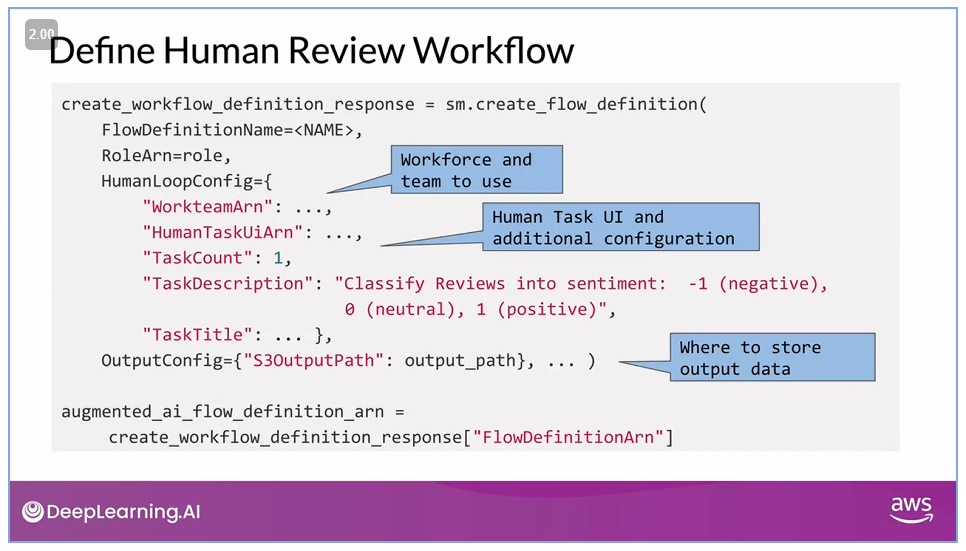

4. (a) **Start human loop with AWS service API calls**: Amazon A2I provides built-in human review workflows for common ML use cases such as content moderation and text extraction from documents. For this purpose, it is integrated with AWS AI services, including Amazon Textract. You can also create your custom workflows to integrate with additional AI services or ML models build on SageMaker or any other tools.

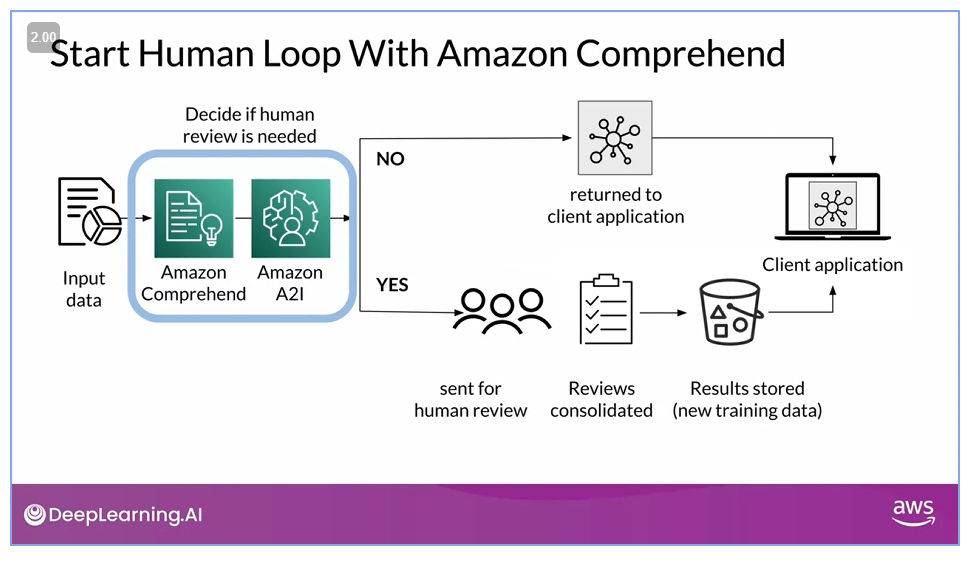

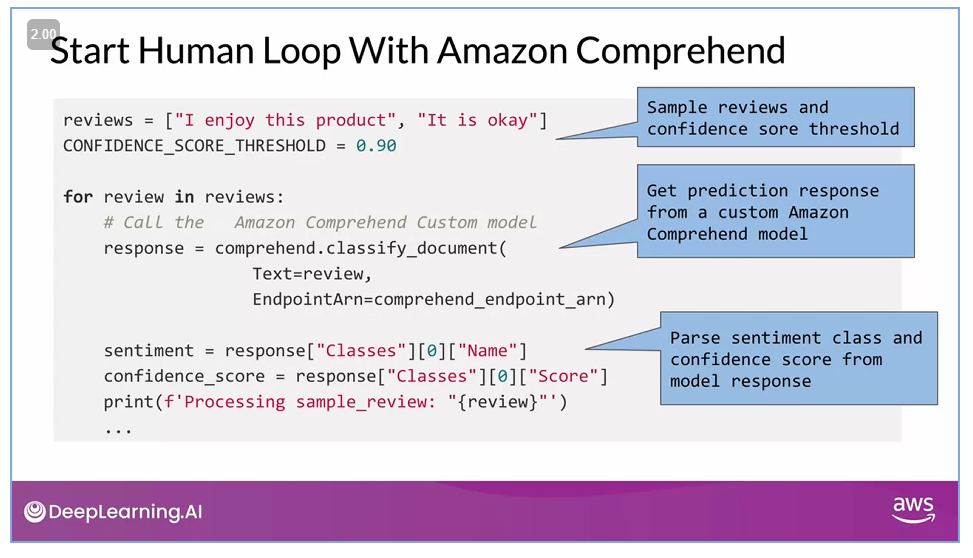

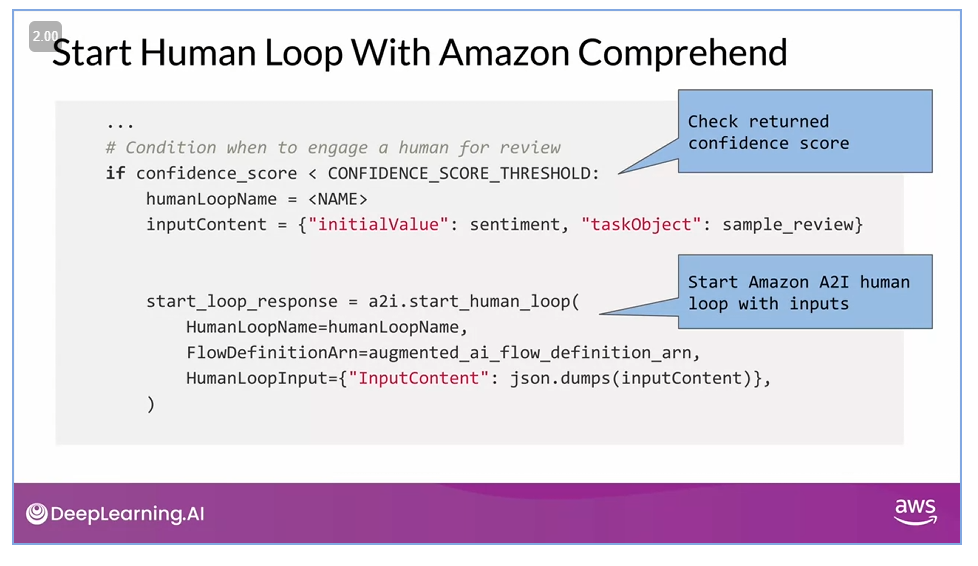

4. (b) **Start human loop with custom ML models**: like the previous example of how Amazon A2I can work with AWS AI Services, you can also use it to review real-time low confidence predictions made by a model deployed to a SageMaker hosted endpoint and incrementally train your model using Amazon AI output data. 

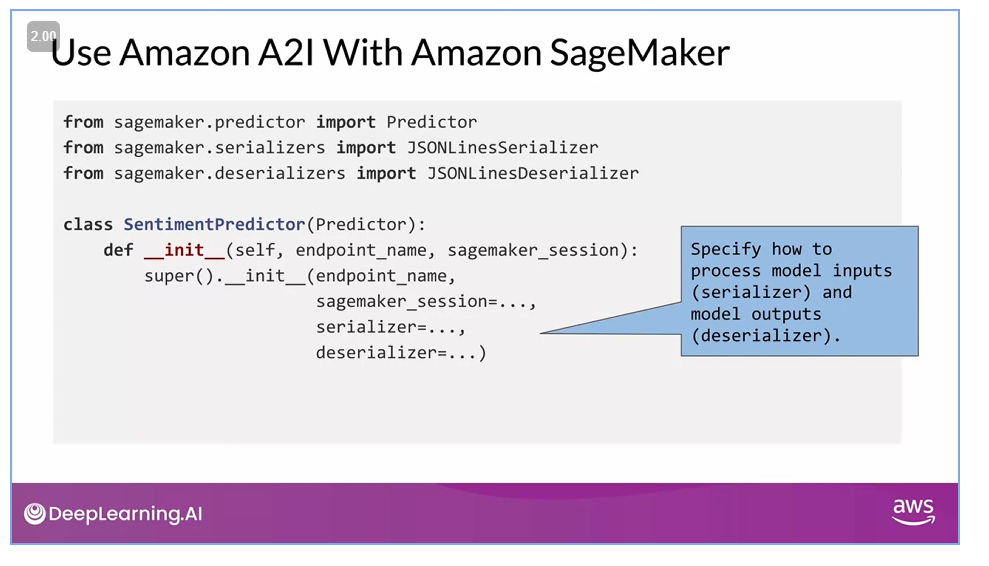

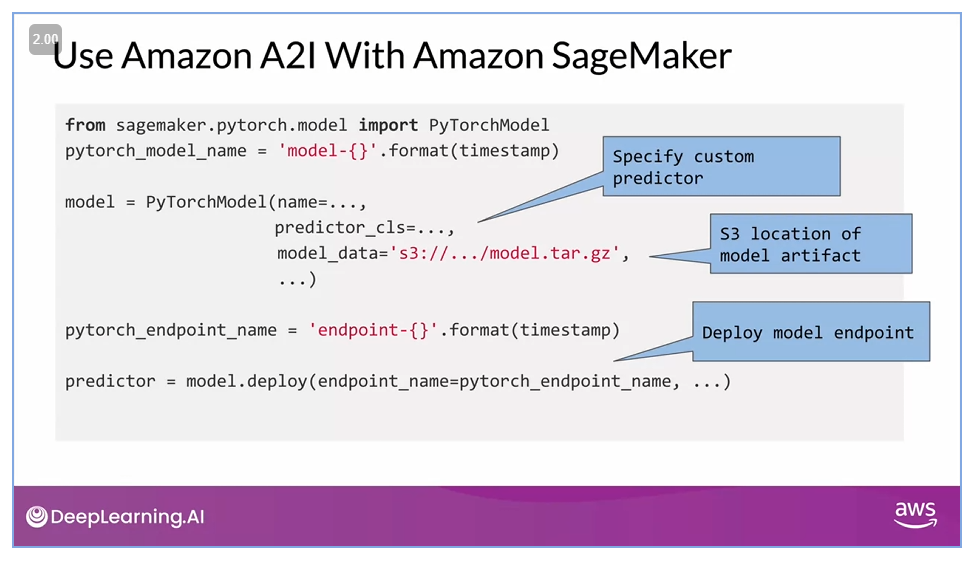

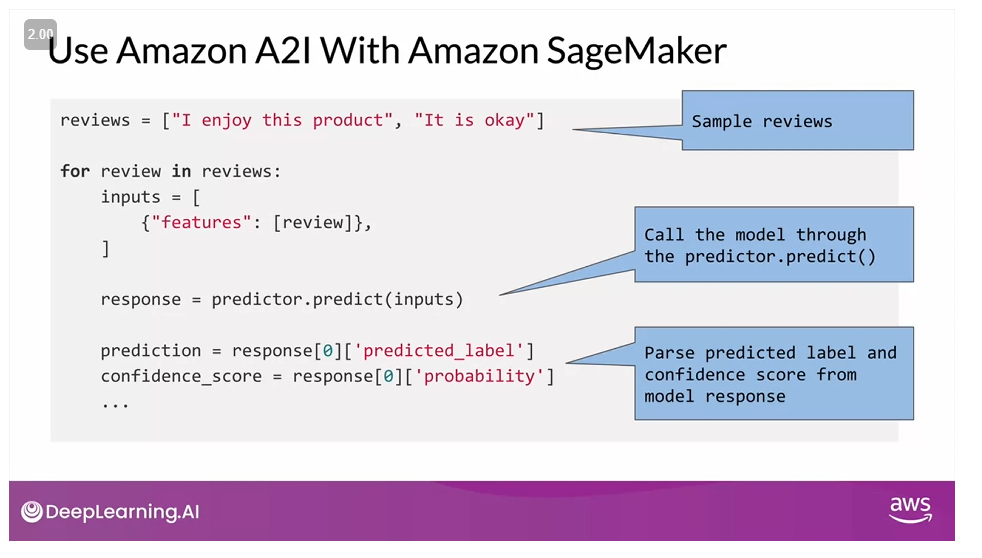

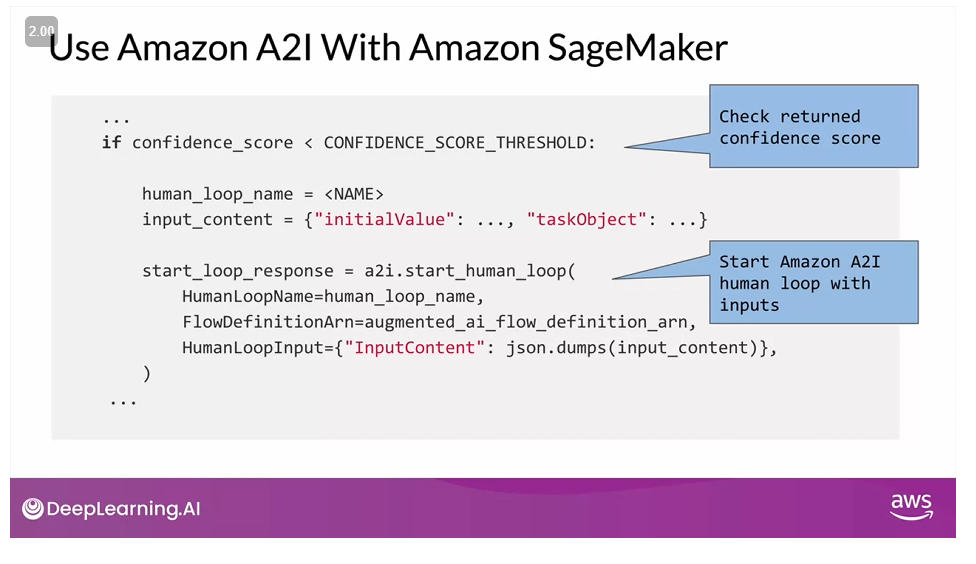

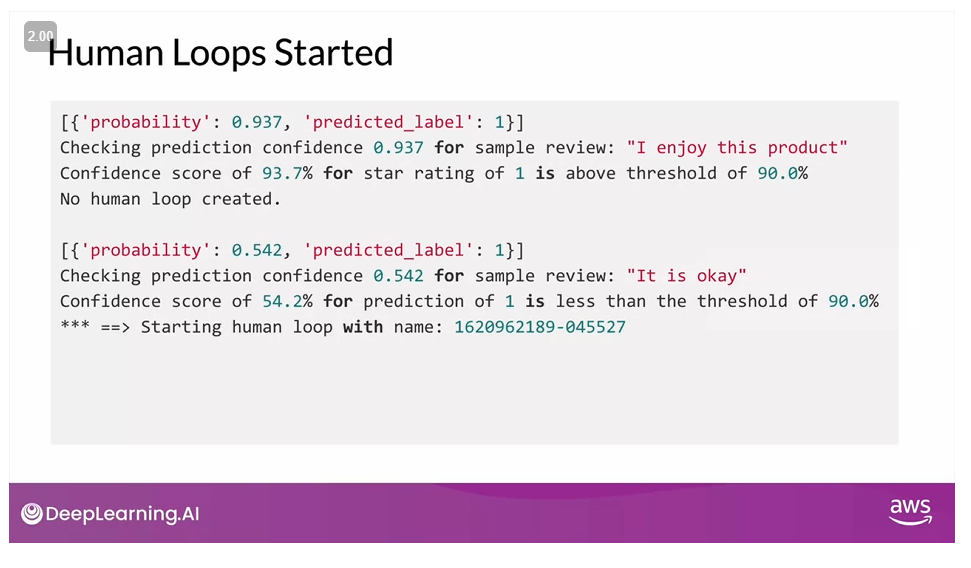

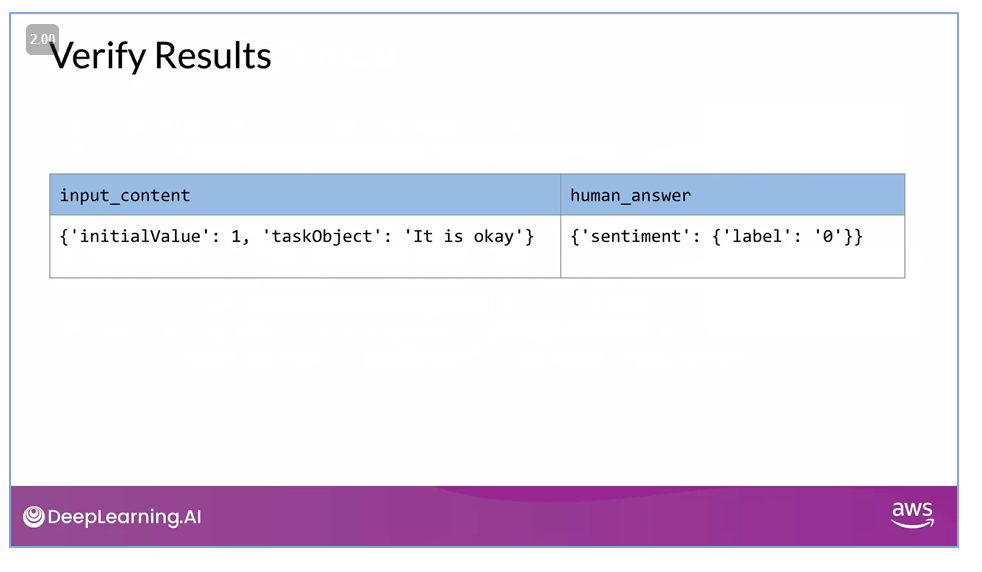